# CNN Waste Classification 2: Modeling

This is the modeling notebook for the cnn-waste-classification study.  Having loaded, tested, rescaled, grayscaled, and augmented the images in the preceding preprocessing notebook, it's time to train a variety of CNN models on them.  The original images are from the UCI Machine Learning Repository (https://archive.ics.uci.edu/dataset/908/realwaste) - processed imags are saved as .pkl files.

In this notebook, eight simple CNN's built from scratch using keras, followed by fi6fteen transfer learning models.  The best "homebrew" CNN accuracy was model 6, at 33%; the best transfer learning accuracy (82%) was obtained with EfficientNet-B0.  Principal findings are:  1. model performance doesn't necessarily improve with CNN depth nor with the size of dense layers;  2. dropout above 0.2 seems to be catastrophic;  3. models tend to choose the modal class ('Plastic') for every prediction; 4. for classification tasks, accuracy should perhaps be measured against the baseline not of 1/(number of categories) but the relative frequency of the modal class in the testing set; 5. without freezing a random seed, training the same model on the same data with the same training parameters can produce wildly divergent results.

A subsequent notebook (03-cnn-waste-classification-variability.ipynb) was created to explore this last finding.  One of its primary conclusions is that the default learning rate of 0.001 is far too high, causing models to "learn" that "everything is the modal class" early in training.  Notebook 03 is currently being used to get an estimate of an optimal learning rate for this study; once this is derived, it will be interesting to see how this notebook performs with an appropriate learning rate throughout.

In [1]:
# imports, organized a little better

import os
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import PIL
import pickle
import seaborn as sn
import visualkeras
import random
import gc

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils import class_weight
from keras import layers, Input, utils
#from keras.utils import np_utils, plot_model, to_categorical
from keras.models import Sequential, Model
from keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, BatchNormalization, GlobalAveragePooling2D
from keras.callbacks import EarlyStopping
from keras.applications import InceptionV3
from keras.applications.vgg16 import VGG16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import ResNet50, DenseNet121, EfficientNetB0
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from IPython.display import display, Image


%matplotlib inline

2025-08-12 18:08:25.990512: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-12 18:08:26.021214: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-08-12 18:08:26.021254: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-08-12 18:08:26.022289: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-08-12 18:08:26.028043: I tensorflow/core/platform/cpu_feature_guar

In [2]:
# Set a consistent seed value for all stochastic processes.
SEED = 13013

np.random.seed(SEED)
tf.random.set_seed(SEED)
random.seed(SEED)

# needed for some TF ops on GPU
os.environ['TF_DETERMINISTIC_OPS'] = '1'

In [3]:
# there have been a variety of stubborn memory issues
# cuts precision in half, which should help
from tensorflow.keras.mixed_precision import set_global_policy
set_global_policy('mixed_float16')

# should help fix fragmentation issue
os.environ['TF_GPU_ALLOCATOR'] = 'cuda_malloc_async'

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: NVIDIA GeForce RTX 4060 Laptop GPU, compute capability 8.9


2025-08-12 18:08:27.553647: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-12 18:08:27.559517: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-12 18:08:27.561062: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [4]:

# Get the path to the current data files
notebook_path = os.path.abspath('02-cnn-waste-classification-modeling.ipynb')
project_root = os.path.dirname(os.path.dirname(notebook_path))
load_dir = os.path.join(project_root, 'data')

# Loading .pkl files from preprocessing notebook
with open(os.path.join(load_dir, 'RealWaste_X_train_aug.pkl'), 'rb') as fh:
    X_train_aug = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_X_test.pkl'), 'rb') as fh:
    X_test = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_train_aug.pkl'), 'rb') as fh:
    y_train_aug = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_test.pkl'), 'rb') as fh:
    y_test = pickle.load(fh)

2025-08-12 18:08:28.901511: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-12 18:08:28.903168: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-12 18:08:28.904646: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [5]:
# need these as np arrays

X_train_aug = np.asarray(X_train_aug)
X_test = np.asarray(X_test)
y_train_aug = np.asarray(y_train_aug)
y_test = np.asarray(y_test)

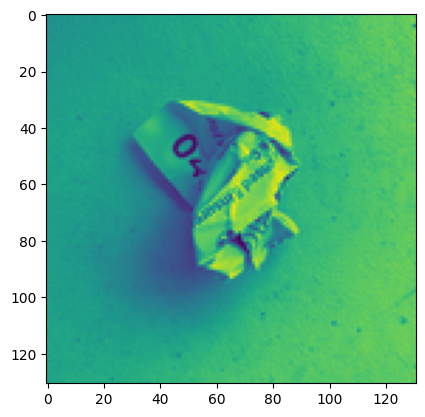

In [6]:
# verify
plt.imshow(X_train_aug[3195])

In [7]:
categories = {'Cardboard': 0,
 'Organics': 1,
 'Glass': 2,
 'Metal': 3,
 'Miscellaneous': 4,
 'Paper': 5,
 'Plastic': 6,
 'Textile Trash': 7,
 'Vegetation': 8}

In [8]:
# I might want that reversed, what's a good way to do that?

r_categories = {v: k for k, v in categories.items()}
r_categories

{0: 'Cardboard',
 1: 'Organics',
 2: 'Glass',
 3: 'Metal',
 4: 'Miscellaneous',
 5: 'Paper',
 6: 'Plastic',
 7: 'Textile Trash',
 8: 'Vegetation'}

I'm going to try to take this notebook in a more object-oriented direction, so I'm going to start by building a class to manage a CNN model, along with its training history and evaluation metrics.

In [9]:
class CNNModel:
    """
    A class to manage a CNN model, along with training history and evaluation metrics.
    """
    def __init__(self, model, model_id=""):
        self.model = model
        self.model_id = model_id
        self.history = None
        self.predictions = None
        self.confusion_matrix = None
        self.cm_df = None
        self.report = None

    def fit_model(self, train_data, validation_data, epochs=12, batch_size=32, verbose=1, **kwargs):
        self.history = self.model.fit(train_data[0], train_data[1], validation_data=validation_data, epochs=epochs, batch_size=batch_size, verbose=verbose, **kwargs)

    def predict_data(self, data_generator):
        self.predictions = np.argmax(self.model.predict(data_generator), axis=1)

    def create_confusion_matrix(self, true_labels, class_names):
        if self.predictions is not None:
            class_indices = sorted(class_names.keys())
            self.confusion_matrix = confusion_matrix(true_labels, self.predictions, labels=class_indices)
            # needed to plot using seaborn
            self.cm_df = pd.DataFrame(self.confusion_matrix, index=[class_names[i] for i in class_indices], columns=[class_names[i] for i in class_indices])
            sn.heatmap(self.cm_df, annot=True, fmt="d")
            sn.heatmap(self.cm_df, annot=True, fmt="d")
            plt.title("Confusion Matrix") # Added a title for clarity
            plt.xlabel("Predicted Label")
            plt.ylabel("True Label")
            plt.show()
            
    def get_classification_report(self, true_labels, target_names):
        if self.predictions is not None:
            self.report = classification_report(true_labels, self.predictions, target_names=target_names)
            print(self.report)
    
    def plot_training_accuracy(self):
        if self.history:
            acc = self.history.history['accuracy']
            val_acc = self.history.history['val_accuracy']
            epochs = range(1, len(acc) + 1)
            plt.plot(epochs, acc, label="Training Accuracy")
            plt.plot(epochs, val_acc, label="Validation Accuracy")
            plt.ylabel("Accuracy")
            plt.xlabel("Epochs")
            plt.xticks(epochs)
            plt.title(f"Training and Validation Accuracy - Model: {self.model_id}")
            plt.legend()
            plt.show()
            
    def get_predicted_label_distribution(self):
        if self.predictions is not None:
            predicted_series = pd.Series(self.predictions)
            return predicted_series.value_counts()
            
    def display_misclassified_examples(self, validation_data, true_labels, class_names, num_examples=5):
        """
        Randomly selects misclassified images from the validation set and displays them
        with their predicted and true labels.
        """
        if self.predictions is None:
            print("Model contains no predict values, invoke predict_data() method first.")
            return

        X_test, y_test = validation_data
        misclassified_indices = np.where(self.predictions != true_labels)[0]

        # this is never, ever going to happen
        if not misclassified_indices.size:
            print("No misclassified examples found in the validation set.")
            return

        # Invert the class_names dictionary to map indices to names
        inverted_class_names = {v: k for k, v in class_names.items()}
        num_to_show = min(num_examples, misclassified_indices.size)
        random_indices = random.sample(list(misclassified_indices), num_to_show)

        num_cols = 4
        num_rows = (num_to_show + num_cols - 1) // num_cols  # Calculate the number of rows needed

        plt.figure(figsize=(12, 3 * num_rows))  # Adjust figure height based on the number of rows
        for i, index in enumerate(random_indices):
            plt.subplot(num_rows, num_cols, i + 1)
            plt.imshow(X_test[index])
            predicted_class_index = self.predictions[index]
            true_class_index = true_labels[index]
            predicted_class_name = inverted_class_names.get(predicted_class_index, f"Unknown Pred: {predicted_class_index}")
            true_class_name = inverted_class_names.get(true_class_index, f"Unknown True: {true_class_index}")
            plt.title(f"P: {predicted_class_name}\nT: {true_class_name}")
            plt.axis('off')
        plt.tight_layout()
        plt.show()
       

After fitting a couple of models, I realized that I would also need to choose specific images given their predicted and actual labels; I used a function for this, as I'd already fit several models and adding a method to the class would require retraining all of them.

In [10]:
def display_specific_predictions(cnn_model, validation_data, true_labels, category_labels, predicted_label, actual_label, num_examples=5):
    """
    Randomly selects images from the validation set that were predicted as
    predicted_label and actually belong to actual_label
    """
    if cnn_model.predictions is None:
        print("Model has no predicted values, run predict_data() first")
        return

    X_test, y_test = validation_data
    inverted_category_labels = {v: k for k, v in category_labels.items()}

    predicted_class_index = category_labels.get(predicted_label)
    actual_class_index = category_labels.get(actual_label)

    if predicted_class_index is None or actual_class_index is None:
        print(f"Error: One or both of the specified categories not found in category_labels.")
        return

    # Find indices where the prediction matches predicted_label
    predicted_indices = np.where(cnn_model.predictions == predicted_class_index)[0]

    # Further filter for indices where the true label matches actual_label
    specific_indices = [
        idx for idx in predicted_indices if true_labels[idx] == actual_class_index
    ]

    if not specific_indices:
        print(f"No examples found where predicted '{predicted_label}' and true '{actual_label}'.")
        return

    num_to_show = min(num_examples, len(specific_indices))
    random_indices_to_show = random.sample(specific_indices, num_to_show)

    num_cols = 4
    num_rows = (num_to_show + num_cols - 1) // num_cols

    plt.figure(figsize=(12, 3 * num_rows))
    for i, index in enumerate(random_indices_to_show):
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(X_test[index])
        predicted_class_name = inverted_category_labels.get(cnn_model.predictions[index], f"Unknown Pred: {cnn_model.predictions[index]}")
        true_class_name = inverted_category_labels.get(true_labels[index], f"Unknown True: {true_labels[index]}")
        plt.title(f"P: {predicted_class_name}\nT: {true_class_name}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

In [11]:
# yes, having cat_labels_r is clunky and awful, I should go back and make this better 

def model_evaluation(model, test_data, cat_labels, cat_labels_r, num_imgs=10):
    model.predict_data(test_data[0])
    model.get_classification_report(test_data[1], cat_labels)
    model.plot_training_accuracy()
    model.create_confusion_matrix(test_data[1], cat_labels_r)
    model.display_misclassified_examples(test_data, test_data[1], cat_labels, num_examples=num_imgs)

In [12]:
# Get the list of all unique labels.
unique_labels = sorted(list(set(y_train_aug)))

# Convert both parameters to numpy arrays.
y_train_np = np.array(y_train_aug)
classes_np = np.array(unique_labels)

# Calculate class weights
weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=classes_np,
    y=y_train_np
)

# Convert to a dictionary for use in the model's fit method.
class_weights = {i: weight for i, weight in enumerate(weights)}

print(class_weights)

{0: 1.1830065359477124, 1: 1.2644710578842315, 2: 1.2066666666666668, 3: 0.6693079767564712, 4: 1.0829059829059828, 5: 1.069198312236287, 6: 0.5564339042599912, 7: 1.643320363164721, 8: 1.2876016260162602}


Applying these class weights increased training time by about _sixty_ times.  I'm skeptical that they'll produce anything like a commensurate improvement in model training, so I'm abandoning them.

## Classification using CNN's "from scratch"

Before using established, standard CNN's through transfer learning, I thought I'd start with some very simple models made from scratch, in order to familiarize myself with the training procedure.

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 32)        0         
 D)                                                              
                                                                 
 flatten (Flatten)           (None, 135200)            0         
                                                                 
 dense (Dense)               (None, 256)               34611456  
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                        

/home/appuser/.local/lib/python3.11/site-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


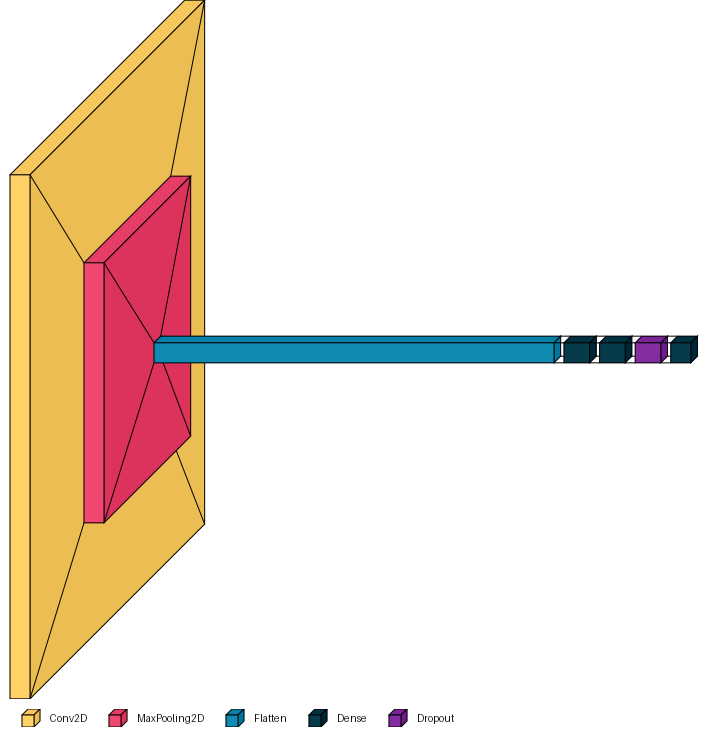

In [13]:
# starting with a very basic convolutional model


CNN_model_1 = Sequential([
    Conv2D(32,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Flatten(),
    Dense(256,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

CNN_model_1.summary()
visualkeras.layered_view(CNN_model_1, legend=True)

visualkeras.layered_view() is a lot less impressive than I'd expected, at least in this instance. I'm not sure I'm going to continue doing that; at any rate, let's try this most basic of models.

In [14]:
CNN_model_1.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)
tf.keras.backend.clear_session()
CNN_1 = CNNModel(CNN_model_1, "basic CNN 1")

CNN_1.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20) 


Epoch 1/20


2025-08-12 15:50:24.295592: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8906


  1/238 [..............................] - ETA: 5:43 - loss: 31.9844 - accuracy: 0.0000e+00

2025-08-12 15:50:25.167217: I external/local_xla/xla/service/service.cc:168] XLA service 0x7371f800fb70 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-08-12 15:50:25.167249: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2025-08-12 15:50:25.170688: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1755013825.216355   26374 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


238/238 [==============================] - 6s 20ms/step - loss: inf - accuracy: 0.1840 - val_loss: 2.1593 - val_accuracy: 0.1703
Epoch 2/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1431 - accuracy: 0.1997 - val_loss: 2.1566 - val_accuracy: 0.1703
Epoch 3/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1389 - accuracy: 0.1997 - val_loss: 2.1580 - val_accuracy: 0.1703
Epoch 4/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1386 - accuracy: 0.1997 - val_loss: 2.1579 - val_accuracy: 0.1703
Epoch 5/20
238/238 [==============================] - 4s 19ms/step - loss: 2.1387 - accuracy: 0.1997 - val_loss: 2.1584 - val_accuracy: 0.1703
Epoch 6/20
238/238 [==============================] - 5s 20ms/step - loss: 2.1389 - accuracy: 0.1997 - val_loss: 2.1577 - val_accuracy: 0.1703
Epoch 7/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1391 - accuracy: 0.1997 - val_loss: 2.1589 - val_accuracy: 0.1703
Epoch 8/20
23

30/30 [==============================] - 0s 2ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


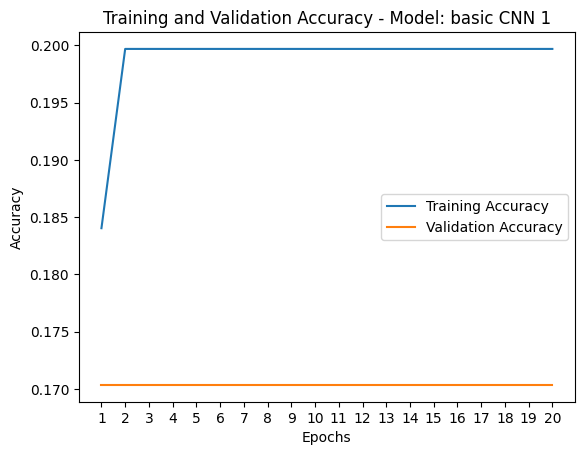

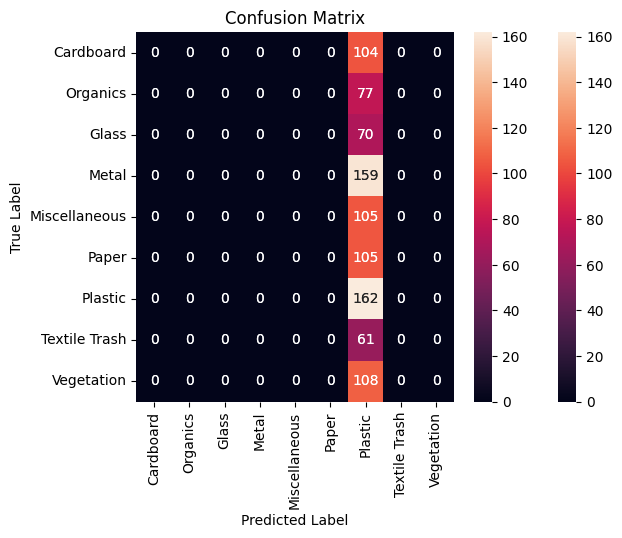

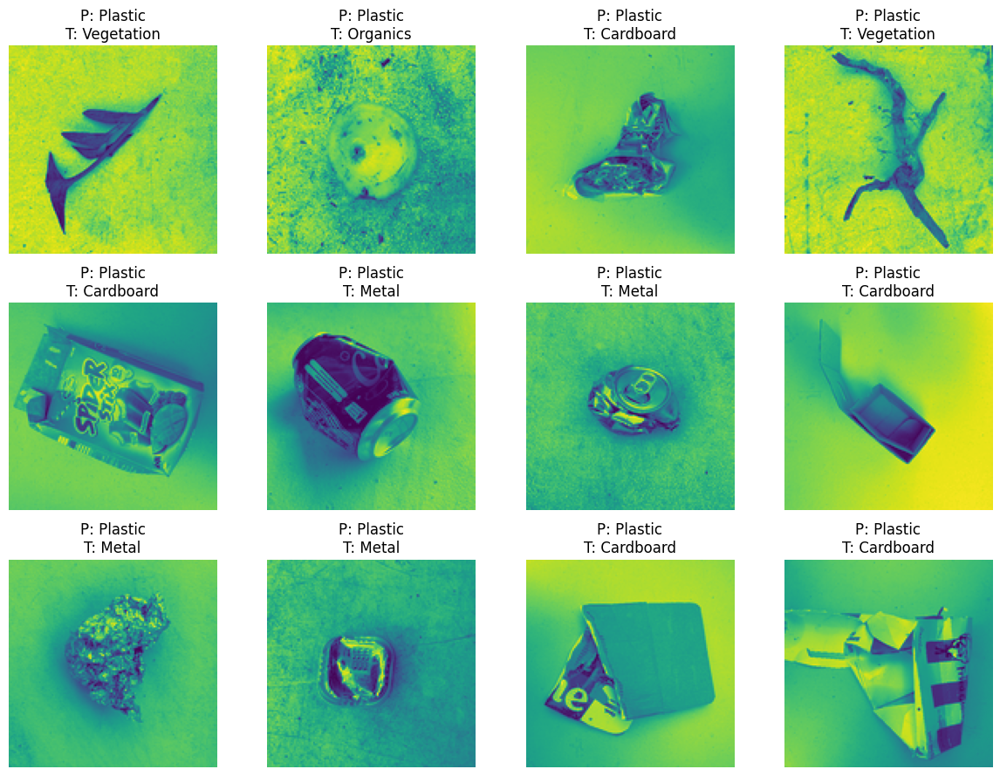

In [15]:
model_evaluation(CNN_1, (X_test, y_test), categories, r_categories, 12)

Plainly, this first model is a simple failure - it thinks everything is plastic, which, perhaps, is the best blind guess as it's the class with the highest frequency.  But a CNN with so few layers shouldn't be expected to learn much.

In [16]:
# a second model, barely more extensive

CNN_model_2 = Sequential([
    Conv2D(32,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Flatten(),
    Dense(256,activation='relu'),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

CNN_model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 32)        0         
 D)                                                              
                                                                 
 flatten (Flatten)           (None, 135200)            0         
                                                                 
 dense (Dense)               (None, 256)               34611456  
                                                                 
 dense_1 (Dense)             (None, 512)               131584    
                                                                 
 dense_2 (Dense)             (None, 256)               131328    
                                                        

In [17]:
CNN_model_2.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# this proved a needed insertion
tf.keras.backend.clear_session()

CNN_2 = CNNModel(CNN_model_2, "basic CNN 2")
CNN_2.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 5s 19ms/step - loss: 23.7017 - accuracy: 0.1781 - val_loss: 2.1684 - val_accuracy: 0.1725
Epoch 2/20
238/238 [==============================] - 4s 18ms/step - loss: 2.2756 - accuracy: 0.2273 - val_loss: 2.1802 - val_accuracy: 0.1714
Epoch 3/20
238/238 [==============================] - 4s 18ms/step - loss: 2.0813 - accuracy: 0.2382 - val_loss: 2.1783 - val_accuracy: 0.1703
Epoch 4/20
238/238 [==============================] - 4s 18ms/step - loss: 2.0377 - accuracy: 0.2564 - val_loss: 2.1680 - val_accuracy: 0.1703
Epoch 5/20
238/238 [==============================] - 4s 18ms/step - loss: 1.9867 - accuracy: 0.2699 - val_loss: 2.1629 - val_accuracy: 0.1703
Epoch 6/20
238/238 [==============================] - 4s 18ms/step - loss: 1.9279 - accuracy: 0.2903 - val_loss: 2.1730 - val_accuracy: 0.1703
Epoch 7/20
238/238 [==============================] - 4s 18ms/step - loss: 1.8458 - accuracy: 0.3243 - val_loss: 2.1669 - val_accuracy: 0.171

30/30 [==============================] - 0s 2ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


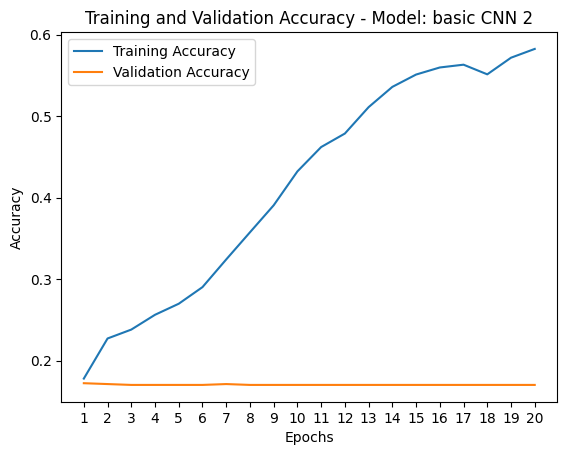

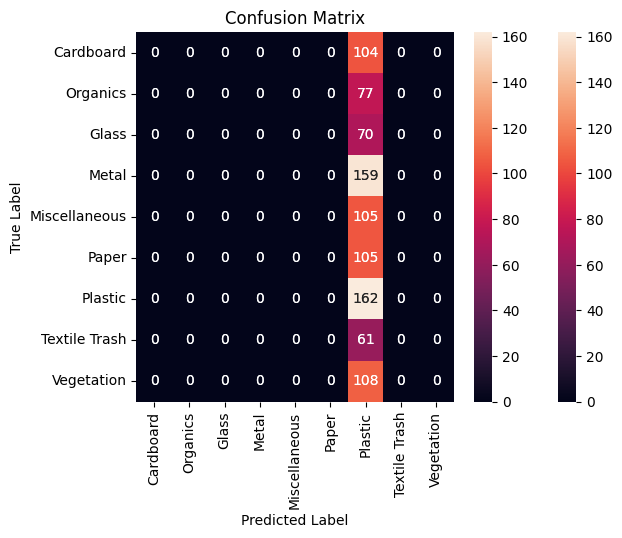

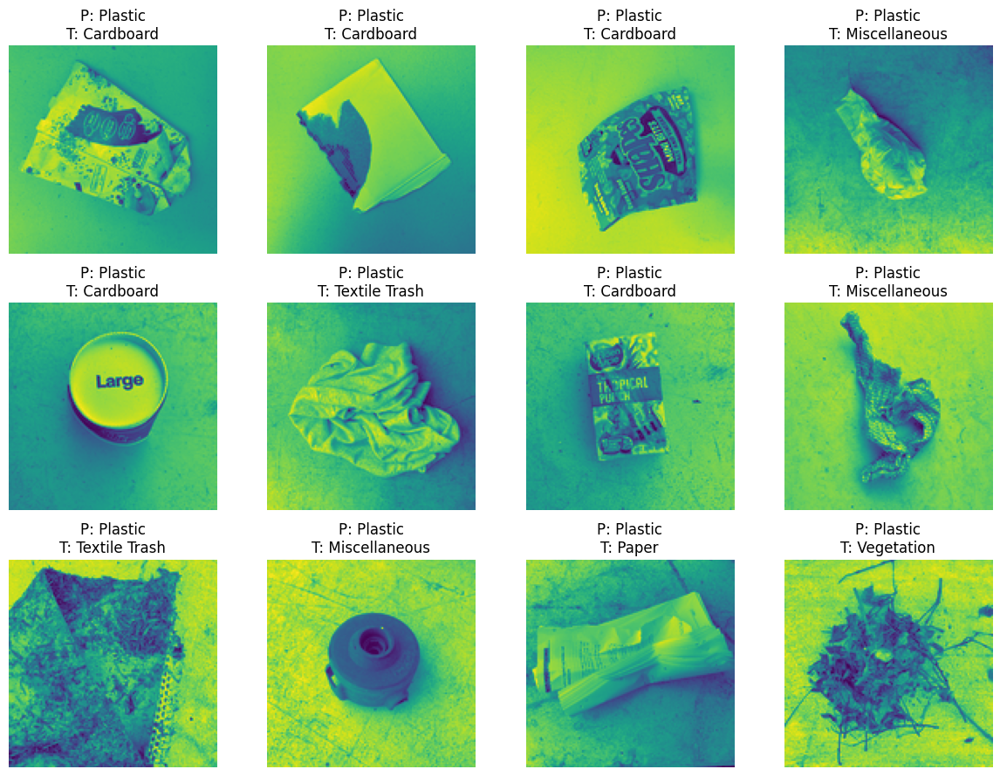

In [18]:
model_evaluation(CNN_2, (X_test, y_test), categories, r_categories, 12)

Obviously we still don't have an adequate model.

In [19]:
CNN_model_3 = Sequential([
    Conv2D(64,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(32,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

CNN_model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 64)      640       
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 64)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 65, 65, 32)        18464     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 32)        0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 1024)              3

In [20]:
CNN_model_3.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

tf.keras.backend.clear_session()


CNN_3 = CNNModel(CNN_model_3, "basic CNN 3")
CNN_3.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 7s 25ms/step - loss: 8.0263 - accuracy: 0.1953 - val_loss: 2.1415 - val_accuracy: 0.1966
Epoch 2/20
238/238 [==============================] - 6s 24ms/step - loss: 2.1090 - accuracy: 0.2198 - val_loss: 2.1324 - val_accuracy: 0.2008
Epoch 3/20
238/238 [==============================] - 6s 24ms/step - loss: 2.0737 - accuracy: 0.2440 - val_loss: 2.2007 - val_accuracy: 0.1914
Epoch 4/20
238/238 [==============================] - 6s 24ms/step - loss: 2.0034 - accuracy: 0.2730 - val_loss: 2.1771 - val_accuracy: 0.1935
Epoch 5/20
238/238 [==============================] - 6s 24ms/step - loss: 1.8951 - accuracy: 0.3149 - val_loss: 2.4379 - val_accuracy: 0.1956
Epoch 6/20
238/238 [==============================] - 6s 24ms/step - loss: 1.7961 - accuracy: 0.3599 - val_loss: 2.4058 - val_accuracy: 0.1956
Epoch 7/20
238/238 [==============================] - 6s 24ms/step - loss: 1.7000 - accuracy: 0.4012 - val_loss: 2.4305 - val_accuracy: 0.1872

30/30 [==============================] - 0s 3ms/step
               precision    recall  f1-score   support

    Cardboard       0.20      0.08      0.11       104
     Organics       0.18      0.03      0.05        77
        Glass       0.00      0.00      0.00        70
        Metal       0.29      0.21      0.25       159
Miscellaneous       0.27      0.06      0.09       105
        Paper       0.12      0.06      0.08       105
      Plastic       0.20      0.84      0.32       162
Textile Trash       0.12      0.03      0.05        61
   Vegetation       0.40      0.02      0.04       108

     accuracy                           0.21       951
    macro avg       0.20      0.15      0.11       951
 weighted avg       0.22      0.21      0.14       951



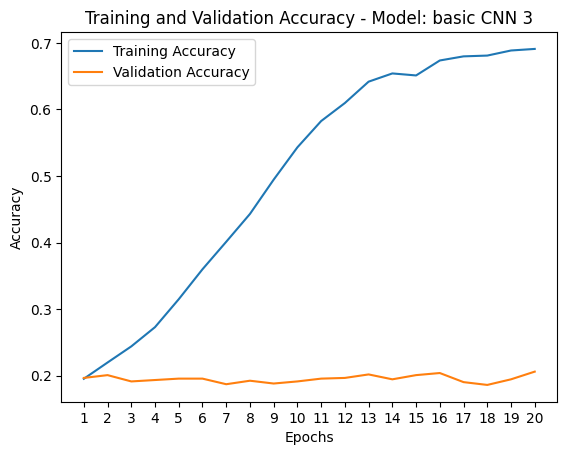

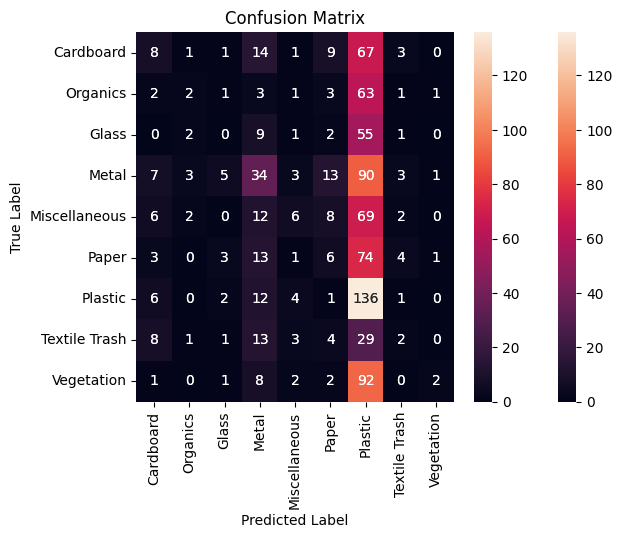

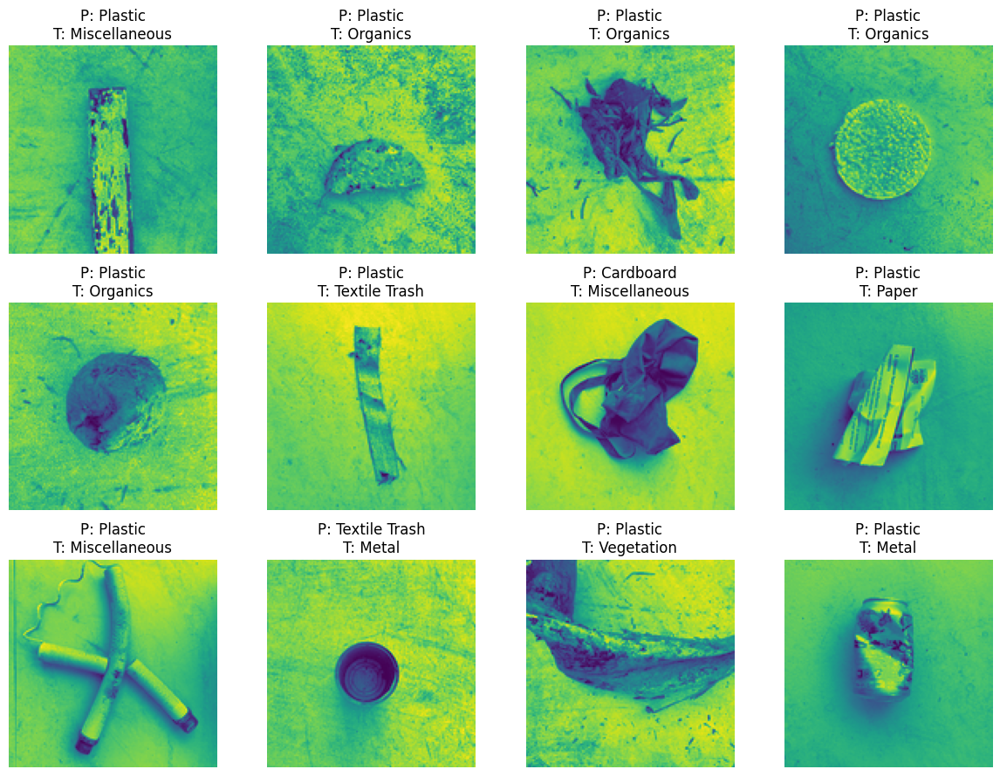

In [21]:
model_evaluation(CNN_3, (X_test, y_test), categories, r_categories, 12)

Finally, a model that seems to have _learned_ at least a little... Note how it still tends to identify everything as plastic, but now also makes a lot of "Metal" (the second most represented category) predictions.  But this is still not great, with accuracy of only 0.21.  I need more of a model.  

In [22]:
CNN_model_4 = Sequential([
    Conv2D(128,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

CNN_model_4.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 128)     1280      
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 128)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 65, 65, 64)        73792     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 64)        36928     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 16, 16, 64)        0

CNN_model_4.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

tf.keras.backend.clear_session()


CNN_4 = CNNModel(CNN_model_4, "basic CNN 4")
CNN_4.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

30/30 [==============================] - 0s 4ms/step
               precision    recall  f1-score   support

    Cardboard       0.21      0.22      0.22       104
     Organics       0.29      0.36      0.33        77
        Glass       0.28      0.40      0.33        70
        Metal       0.37      0.36      0.37       159
Miscellaneous       0.12      0.11      0.12       105
        Paper       0.29      0.29      0.29       105
      Plastic       0.32      0.36      0.34       162
Textile Trash       0.11      0.05      0.07        61
   Vegetation       0.47      0.34      0.40       108

     accuracy                           0.29       951
    macro avg       0.27      0.28      0.27       951
 weighted avg       0.29      0.29      0.29       951



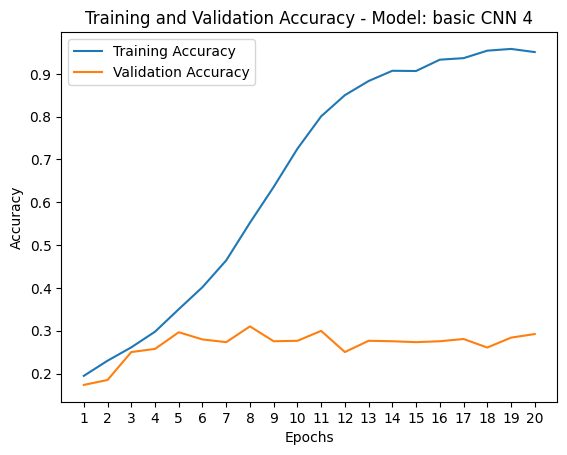

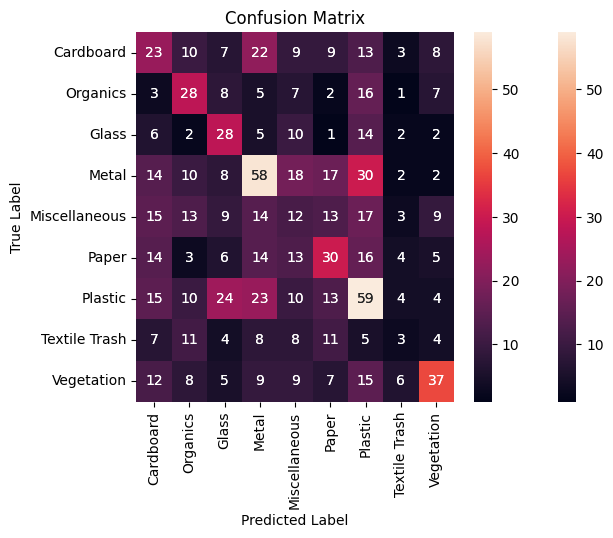

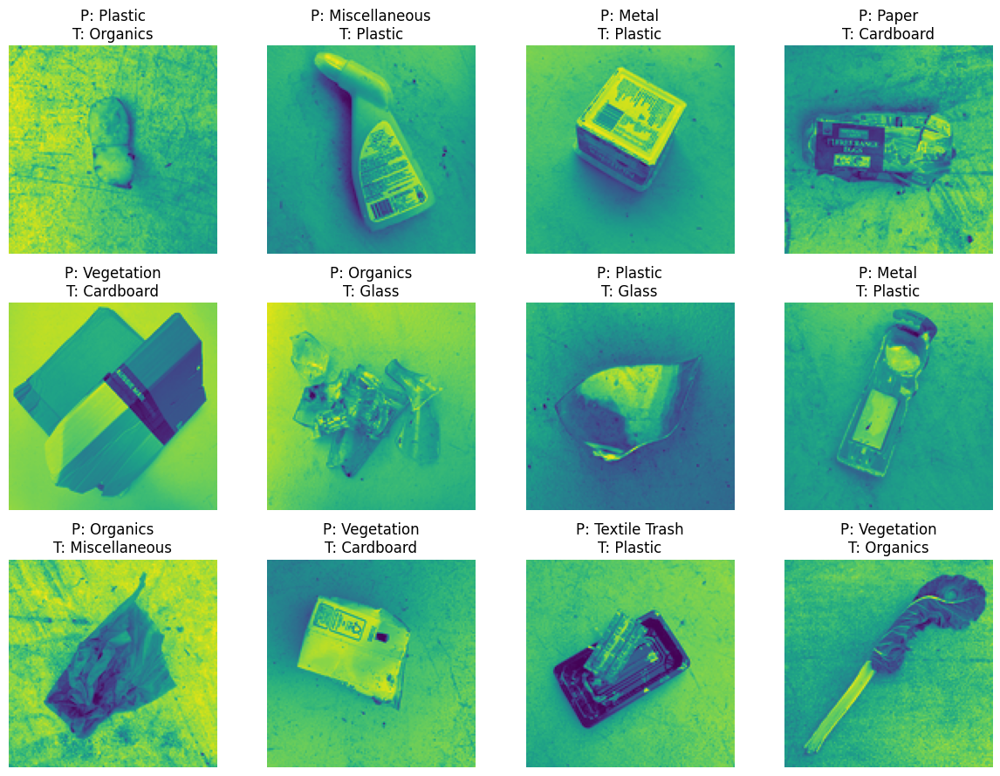

In [24]:
model_evaluation(CNN_4, (X_test, y_test), categories, r_categories, 12)

This is quite an improvement:  overall accuracy rose to 0.29.  As we can see from the F1 scores as well as the confusion matrix, this model learned to identify metal, paper, and especially vegetation, in addition to plastic.  It's still of course usually wrong, but it represents a substantial improvement over the "everything is plastic" results we've seen before.  

This leads me to question:  what's an appropriate baseline for accuracy in a classifcation task?  I had been thinking very naively that, with nine categories, the "blind guess" accuracy should be 1/9, or 0.1111...  however, looking at a few very obviously failed models, and considering how they're failing here - by simply predicting everything to be in the modal class - this seems glaringly incorrect.  Maybe a better assessment is to compare a model's accuracy to the accuracy it would obtain by uniformly predicting that modal class; that is, the relative frequency of that modal class _in the validation set_.  I'm going to think on this more, as simple accuracy is a very limited metric.

In [25]:
CNN_model_5 = Sequential([
    Conv2D(128,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(256,activation='relu'),
    Dropout(0.1),
    Dense(9,activation='softmax')
    ])

CNN_model_5.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 128)     1280      
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 128)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 65, 65, 64)        73792     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 64)        36928     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 16, 16, 64)        0

In [26]:
CNN_model_5.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)
CNN_5 = CNNModel(CNN_model_5, "basic CNN 5")
CNN_5.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 9s 33ms/step - loss: 2.5523 - accuracy: 0.1984 - val_loss: 2.1396 - val_accuracy: 0.1903
Epoch 2/20
238/238 [==============================] - 7s 31ms/step - loss: 2.1126 - accuracy: 0.2294 - val_loss: 2.1507 - val_accuracy: 0.1893
Epoch 3/20
238/238 [==============================] - 8s 32ms/step - loss: 2.0703 - accuracy: 0.2351 - val_loss: 2.1513 - val_accuracy: 0.1882
Epoch 4/20
238/238 [==============================] - 7s 31ms/step - loss: 2.0395 - accuracy: 0.2515 - val_loss: 2.1571 - val_accuracy: 0.1872
Epoch 5/20
238/238 [==============================] - 7s 30ms/step - loss: 1.9986 - accuracy: 0.2669 - val_loss: 2.2271 - val_accuracy: 0.1966
Epoch 6/20
238/238 [==============================] - 7s 30ms/step - loss: 1.9581 - accuracy: 0.2797 - val_loss: 2.1628 - val_accuracy: 0.1893
Epoch 7/20
238/238 [==============================] - 7s 30ms/step - loss: 1.8842 - accuracy: 0.3136 - val_loss: 2.2340 - val_accuracy: 0.1924

30/30 [==============================] - 0s 4ms/step
               precision    recall  f1-score   support

    Cardboard       0.22      0.02      0.04       104
     Organics       0.20      0.01      0.02        77
        Glass       0.00      0.00      0.00        70
        Metal       0.52      0.09      0.16       159
Miscellaneous       0.18      0.03      0.05       105
        Paper       0.22      0.02      0.04       105
      Plastic       0.17      0.93      0.29       162
Textile Trash       0.33      0.10      0.15        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.19       951
    macro avg       0.21      0.13      0.08       951
 weighted avg       0.22      0.19      0.10       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


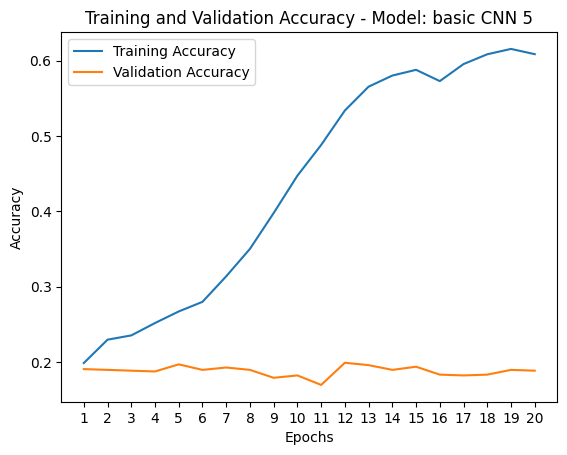

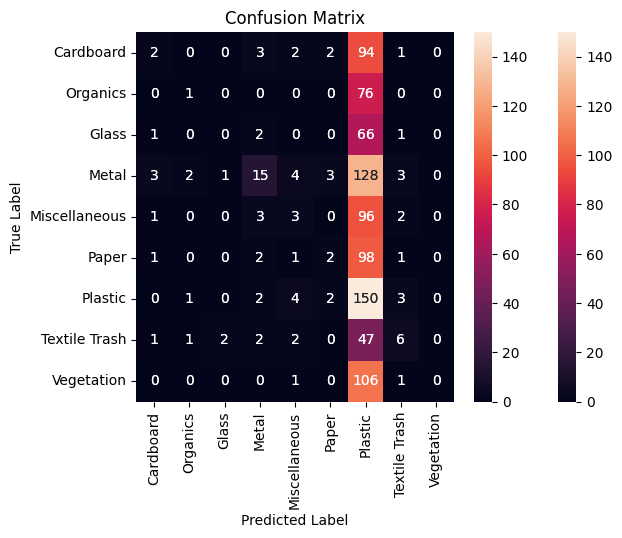

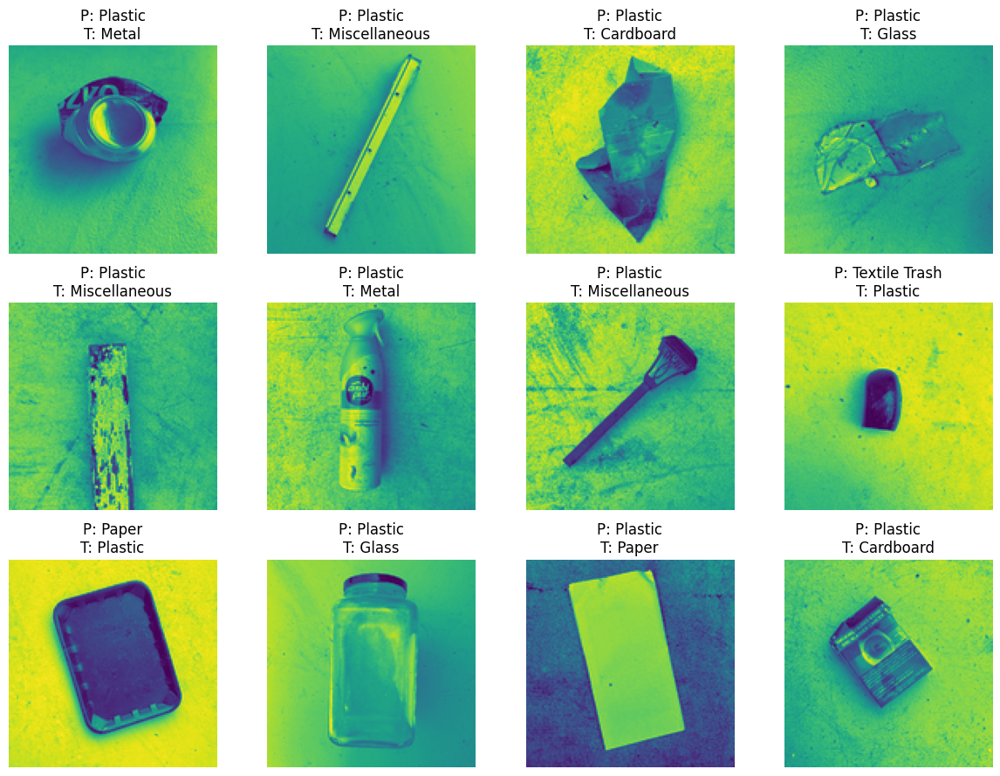

In [27]:
model_evaluation(CNN_5, (X_test, y_test), categories, r_categories, 12)

In [28]:
# let's make these models a little more substantial

CNN_model_6 = Sequential([
    Conv2D(128,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

CNN_model_6.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 128)     1280      
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 128)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 65, 65, 64)        73792     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 64)        36928     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 16, 16, 64)        0

In [29]:
CNN_model_6.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# it could be time to include this
tf.keras.backend.clear_session()
gc.collect()

CNN_6 = CNNModel(CNN_model_6, "basic CNN 6")
CNN_6.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 9s 31ms/step - loss: 2.5770 - accuracy: 0.1973 - val_loss: 2.1294 - val_accuracy: 0.2061
Epoch 2/20
238/238 [==============================] - 7s 30ms/step - loss: 2.0428 - accuracy: 0.2584 - val_loss: 2.0653 - val_accuracy: 0.2387
Epoch 3/20
238/238 [==============================] - 7s 30ms/step - loss: 1.9827 - accuracy: 0.2739 - val_loss: 1.8693 - val_accuracy: 0.2965
Epoch 4/20
238/238 [==============================] - 7s 31ms/step - loss: 1.8804 - accuracy: 0.3093 - val_loss: 1.8759 - val_accuracy: 0.3407
Epoch 5/20
238/238 [==============================] - 7s 31ms/step - loss: 1.9368 - accuracy: 0.3319 - val_loss: 2.1889 - val_accuracy: 0.1672
Epoch 6/20
238/238 [==============================] - 7s 31ms/step - loss: 2.0048 - accuracy: 0.2609 - val_loss: 2.1084 - val_accuracy: 0.1945
Epoch 7/20
238/238 [==============================] - 7s 31ms/step - loss: 2.0292 - accuracy: 0.3049 - val_loss: 2.1613 - val_accuracy: 0.1609

30/30 [==============================] - 0s 4ms/step
               precision    recall  f1-score   support

    Cardboard       0.27      0.15      0.20       104
     Organics       0.40      0.34      0.37        77
        Glass       0.24      0.13      0.17        70
        Metal       0.43      0.49      0.46       159
Miscellaneous       0.19      0.44      0.27       105
        Paper       0.23      0.08      0.11       105
      Plastic       0.34      0.46      0.39       162
Textile Trash       0.21      0.16      0.18        61
   Vegetation       0.68      0.44      0.53       108

     accuracy                           0.33       951
    macro avg       0.33      0.30      0.30       951
 weighted avg       0.35      0.33      0.32       951



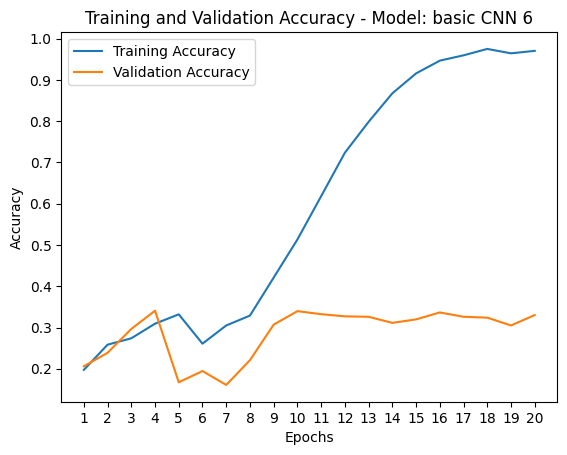

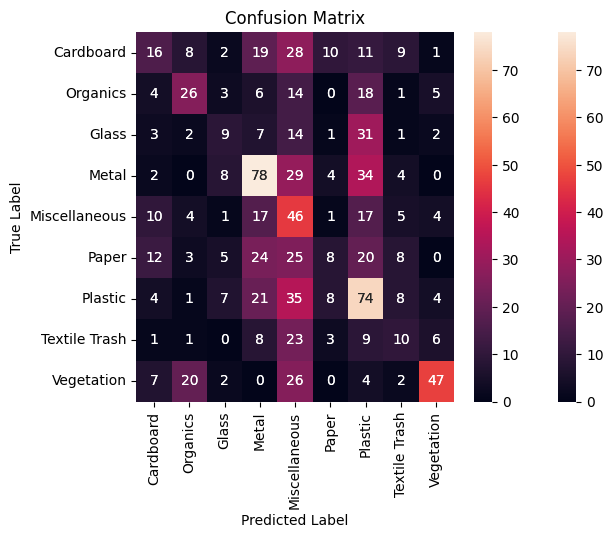

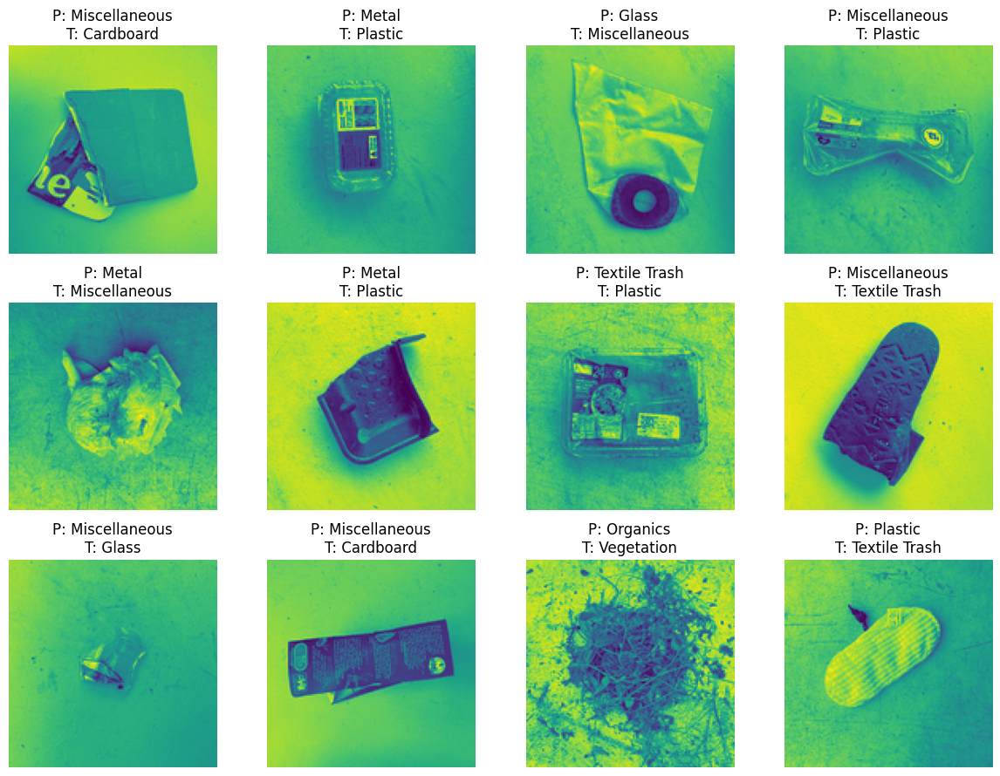

In [30]:
model_evaluation(CNN_6, (X_test, y_test), categories, r_categories, 12)

In [31]:
# what happens if we have a larger kernel size?

CNN_model_7 = Sequential([
    Conv2D(128,(5,5),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.1),
    Dense(9,activation='softmax')
])

CNN_model_7.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 128)     3328      
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 128)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 65, 65, 64)        204864    
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 64)        102464    
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 16, 16, 64)        0

In [32]:
CNN_model_7.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)


tf.keras.backend.clear_session()
gc.collect()


CNN_7 = CNNModel(CNN_model_7, "basic CNN 7")
CNN_7.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 11s 41ms/step - loss: 2.3844 - accuracy: 0.1894 - val_loss: 2.1578 - val_accuracy: 0.1703
Epoch 2/20
238/238 [==============================] - 9s 40ms/step - loss: 2.1418 - accuracy: 0.2017 - val_loss: 2.1600 - val_accuracy: 0.1735
Epoch 3/20
238/238 [==============================] - 10s 40ms/step - loss: 2.1601 - accuracy: 0.2010 - val_loss: 12.6726 - val_accuracy: 0.0641
Epoch 4/20
238/238 [==============================] - 9s 40ms/step - loss: 2.1942 - accuracy: 0.2101 - val_loss: 2.1537 - val_accuracy: 0.2040
Epoch 5/20
238/238 [==============================] - 9s 39ms/step - loss: 2.1174 - accuracy: 0.2244 - val_loss: 2.1568 - val_accuracy: 0.1809
Epoch 6/20
238/238 [==============================] - 9s 40ms/step - loss: 2.0983 - accuracy: 0.2309 - val_loss: 2.1560 - val_accuracy: 0.1977
Epoch 7/20
238/238 [==============================] - 9s 40ms/step - loss: 2.0884 - accuracy: 0.2357 - val_loss: 2.1535 - val_accuracy: 0.1

30/30 [==============================] - 0s 6ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.67      0.10      0.17       159
Miscellaneous       0.25      0.02      0.04       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      0.97      0.30       162
Textile Trash       0.18      0.03      0.06        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.19       951
    macro avg       0.14      0.12      0.06       951
 weighted avg       0.18      0.19      0.09       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


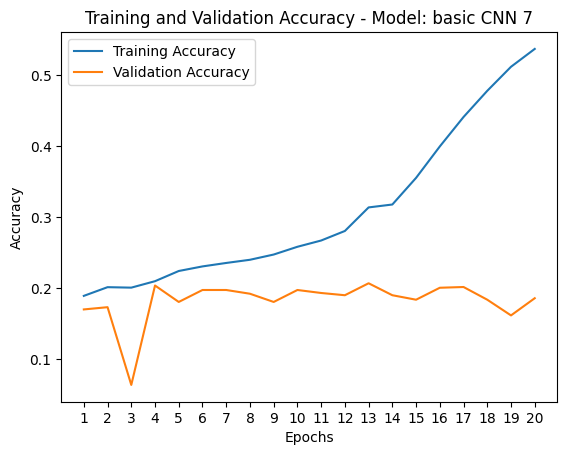

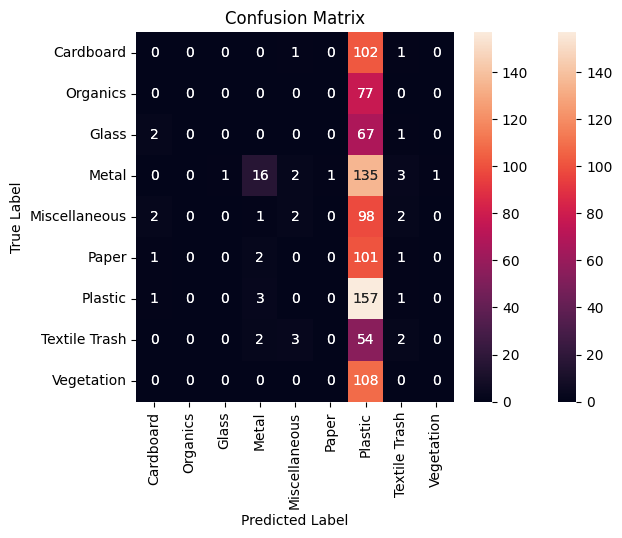

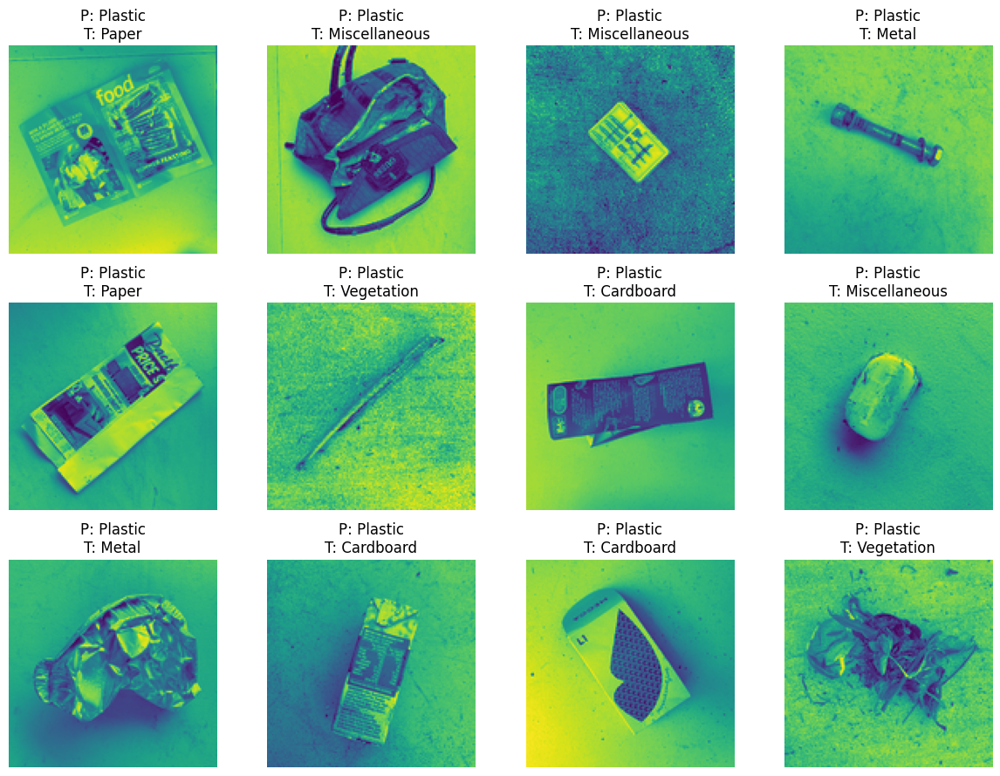

In [33]:
model_evaluation(CNN_7, (X_test, y_test), categories, r_categories, 12)

In [34]:
CNN_model_8 = Sequential([
    Conv2D(128,(5,5),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(32,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(1024,activation='relu'),
    Dropout(0.2),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.1),
    Dense(256,activation='relu'),
    Dense(9,activation='softmax')
])

CNN_model_8.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 131, 131, 128)     3328      
                                                                 
 max_pooling2d (MaxPooling2  (None, 65, 65, 128)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 65, 65, 64)        204864    
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 32)        51232     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 16, 16, 32)        0

In [36]:
CNN_model_8.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)



CNN_8 = CNNModel(CNN_model_8, "basic CNN 8")
CNN_8.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 10s 39ms/step - loss: 2.3080 - accuracy: 0.1897 - val_loss: 2.1566 - val_accuracy: 0.1703
Epoch 2/20
238/238 [==============================] - 9s 37ms/step - loss: 2.1408 - accuracy: 0.1994 - val_loss: 2.1595 - val_accuracy: 0.1703
Epoch 3/20
238/238 [==============================] - 9s 36ms/step - loss: 2.1402 - accuracy: 0.1994 - val_loss: 2.1577 - val_accuracy: 0.1703
Epoch 4/20
238/238 [==============================] - 8s 35ms/step - loss: 2.1400 - accuracy: 0.1973 - val_loss: 2.1594 - val_accuracy: 0.1703
Epoch 5/20
238/238 [==============================] - 8s 35ms/step - loss: 2.1401 - accuracy: 0.1997 - val_loss: 2.1594 - val_accuracy: 0.1703
Epoch 6/20
238/238 [==============================] - 8s 35ms/step - loss: 2.1394 - accuracy: 0.1997 - val_loss: 2.1583 - val_accuracy: 0.1703
Epoch 7/20
238/238 [==============================] - 8s 34ms/step - loss: 2.1398 - accuracy: 0.1997 - val_loss: 2.1610 - val_accuracy: 0.170

30/30 [==============================] - 0s 5ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


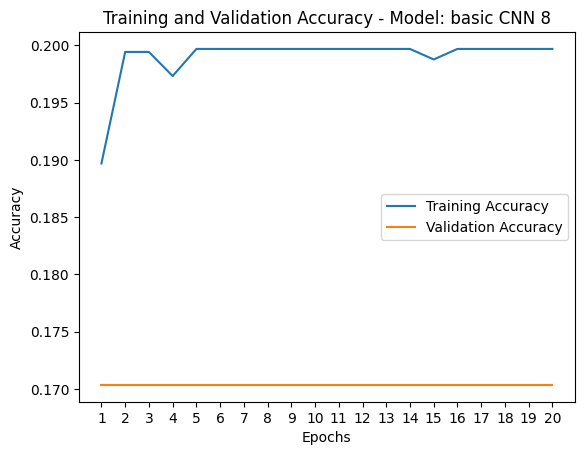

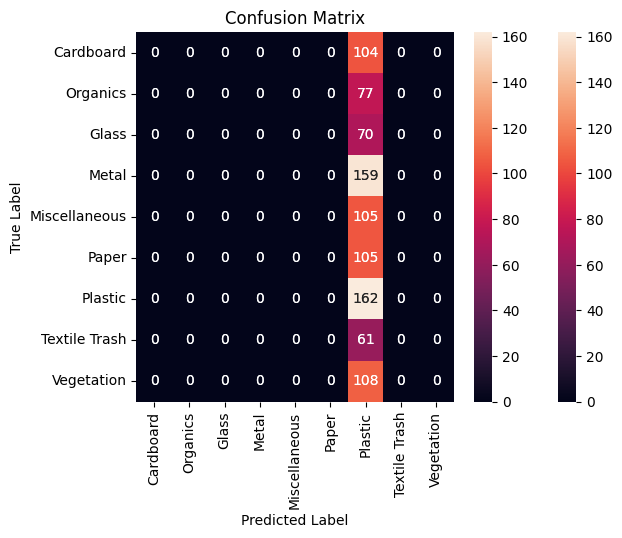

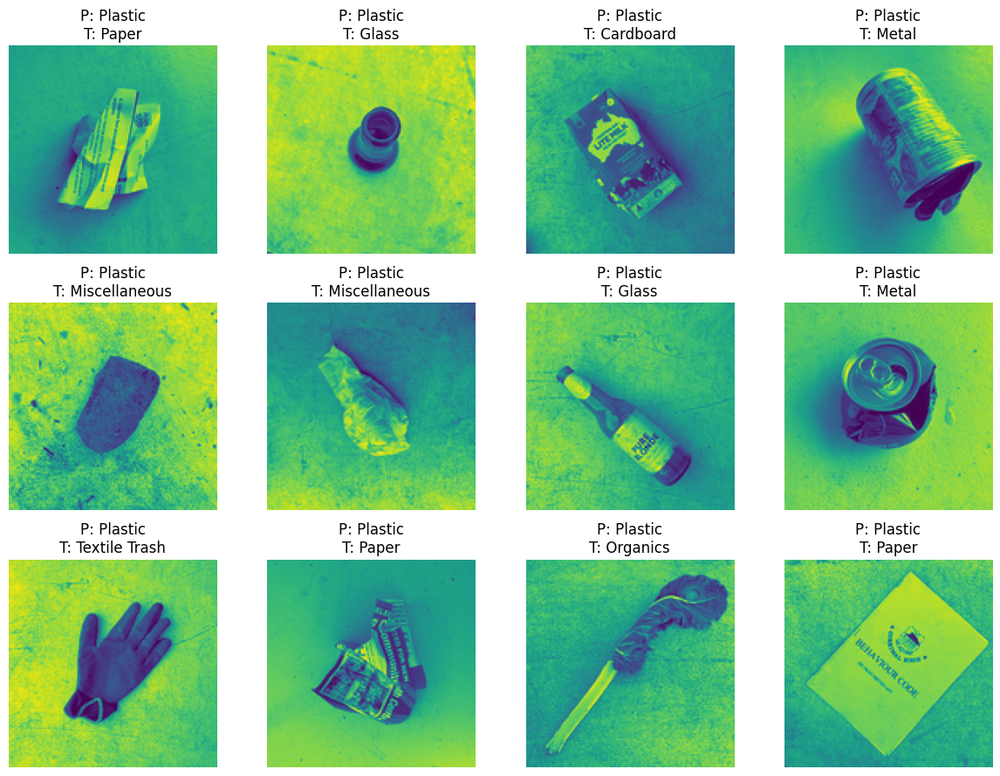

In [37]:
model_evaluation(CNN_8, (X_test, y_test), categories, r_categories, 12)

## Transfer Learning Models

## InceptionV3

A brief investigation reveals that InceptionV3 is designed for RGB images! It's possible to modify the model (it is of course on GitHub) to take monochrome input, and doing this might be worthwhile - but, importantly, the "imagenet" weights (and indeed any other pretrained weights) are trained on 3-channel inputs. The training weights would be, then, pretty much worthless, and training such a model from scratch would take a great deal of processor time, on a system that gets far more mileage out of that time than this machine ever will.

The only other solution seems to be to go back to preprocessing and revert all images to RGB, which will, of course, radically increase run times, and chip away at accuracy for my naive models. I really want to try InceptionV3, so I revised my preprocessing notebook and saved some RGB images.



In [13]:
# it became evident that GPU RAM was going to be an issue
import gc
gc.collect()

del X_train_aug
del y_train_aug
del X_test
del y_test


In [14]:
# went back to preprocessing, removed grayscale conversion, and saved RGB images


# Get the path to the current data files
notebook_path = os.path.abspath('02-cnn-waste-classification-modeling.ipynb')
project_root = os.path.dirname(os.path.dirname(notebook_path))
load_dir = os.path.join(project_root, 'data')



with open(os.path.join(load_dir, 'RealWaste_X_train_aug_RGB.pkl'), 'rb') as fh:
    X_train_aug_RGB = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_X_test_RGB.pkl'), 'rb') as fh:
    X_test_RGB = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_train_aug_RGB.pkl'), 'rb') as fh:
    y_train_aug_RGB = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_test_RGB.pkl'), 'rb') as fh:
    y_test_RGB = pickle.load(fh)

In [15]:
X_train_aug_RGB = np.asarray(X_train_aug_RGB)
X_test_RGB = np.asarray(X_test_RGB)
y_train_aug_RGB = np.asarray(y_train_aug_RGB)
y_test_RGB = np.asarray(y_test_RGB)

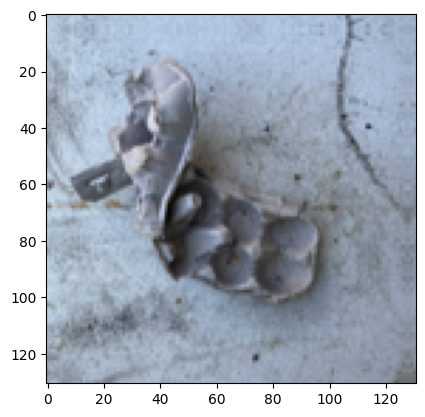

In [16]:
# verify
plt.imshow(X_train_aug_RGB[2194])

In [42]:
# IV3 requires an input_shape parameter

input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 flatten_1 (Flatten)         (None, 8192)              0         
                                                                 
 dense_7 (Dense)             (None, 512)               4194816   
                                                                 
 dense_8 (Dense)             (None, 1024)              525312    
                                                                 
 dense_9 (Dense)             (None, 512)               524800    
                                                                 
 dropout_2 (Dropout)         (None, 512)               0         
                                                                 
 dense_10 (Dense)            (None, 256)              

/home/appuser/.local/lib/python3.11/site-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


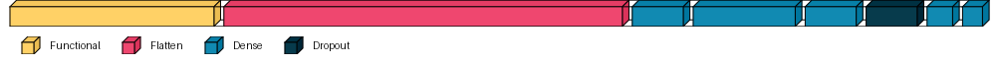

In [43]:
# a very simple IV3 model to start 

IV3_model_1 = Sequential([IV3])
for layer in IV3_model_1.layers:
    layer.trainable = False

# flatten, add final dense layer, add softmax layer
    
IV3_model_1.add(Flatten())    
IV3_model_1.add(Dense(512, activation='relu'))
IV3_model_1.add(Dense(1024, activation='relu'))
IV3_model_1.add(Dense(512, activation='relu'))
IV3_model_1.add(Dropout(0.2))
IV3_model_1.add(Dense(256, activation='relu'))
IV3_model_1.add(Dense(9, activation='softmax'))

IV3_model_1.summary()
visualkeras.layered_view(IV3_model_1, legend=True)

In [44]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_1.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_1 = CNNModel(IV3_model_1, "IV3 model 1")
IV3_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 7s 11ms/step - loss: 5.4302 - accuracy: 0.2623 - val_loss: 2.1586 - val_accuracy: 0.1703
Epoch 2/20
476/476 [==============================] - 4s 9ms/step - loss: 1.7432 - accuracy: 0.3424 - val_loss: 2.1607 - val_accuracy: 0.1703
Epoch 3/20
476/476 [==============================] - 4s 9ms/step - loss: 1.6832 - accuracy: 0.3832 - val_loss: 2.1613 - val_accuracy: 0.1703
Epoch 4/20
476/476 [==============================] - 4s 9ms/step - loss: 1.6387 - accuracy: 0.3957 - val_loss: 2.1646 - val_accuracy: 0.1703
Epoch 5/20
476/476 [==============================] - 4s 9ms/step - loss: 1.5494 - accuracy: 0.4274 - val_loss: 2.1605 - val_accuracy: 0.1703
Epoch 6/20
476/476 [==============================] - 4s 9ms/step - loss: 1.4989 - accuracy: 0.4528 - val_loss: 2.1610 - val_accuracy: 0.1703
Epoch 7/20
476/476 [==============================] - 4s 9ms/step - loss: 1.4818 - accuracy: 0.4571 - val_loss: 2.1613 - val_accuracy: 0.1703
Epoch

30/30 [==============================] - 1s 10ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


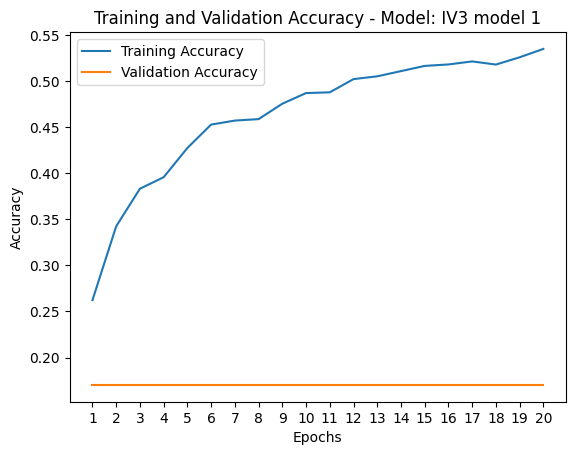

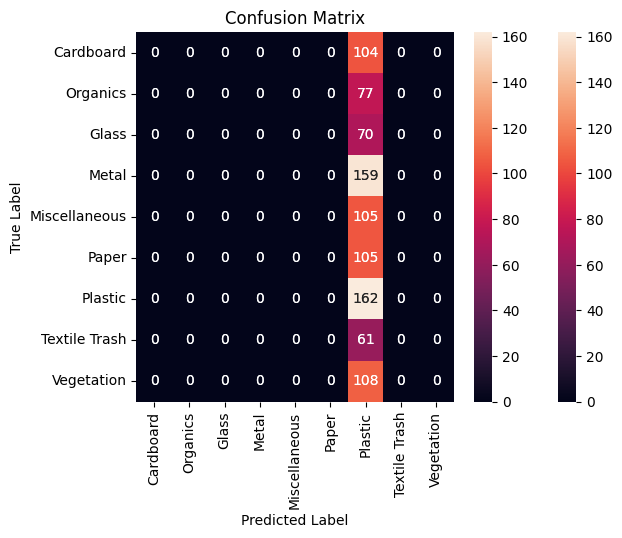

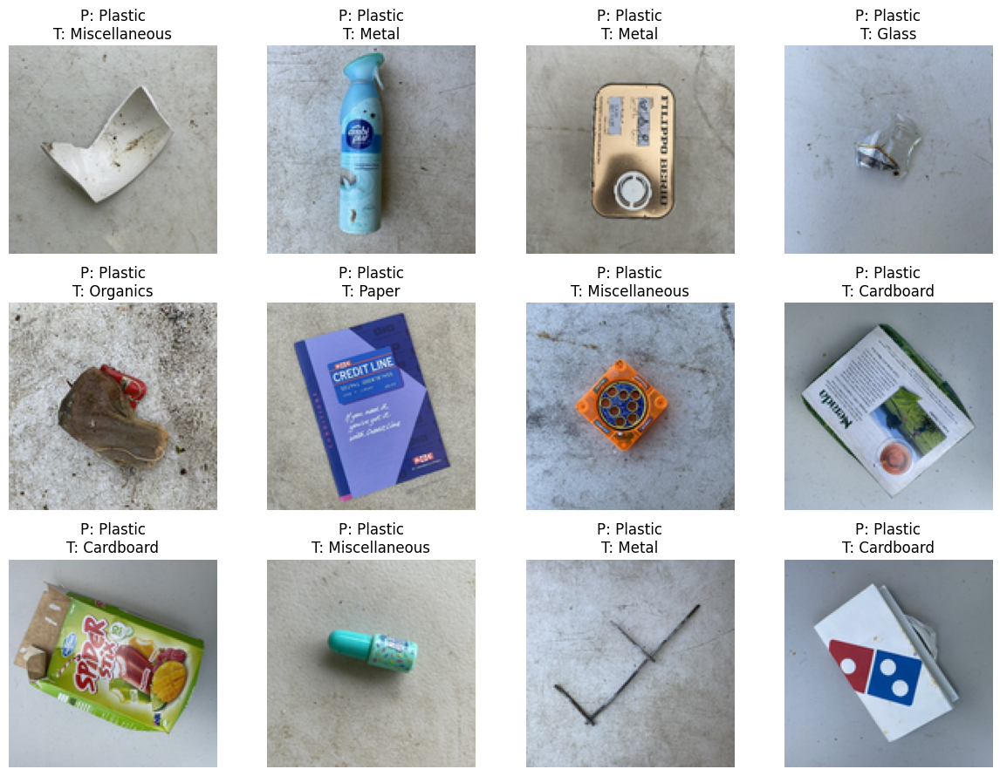

In [45]:
model_evaluation(IV3_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [46]:
# if at some point I'm going to make IV3 layers trainable, it's probably prudent 
# to get in the habit of instantiating them afresh for each model


input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_2 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_2.layers:
    layer.trainable = False

# flatten, add final dense layer, add softmax layer
    
IV3_model_2.add(Flatten())
IV3_model_2.add(Dense(512, activation='relu'))
IV3_model_2.add(Dense(1024, activation='relu'))
IV3_model_2.add(Dense(512, activation='relu'))
IV3_model_2.add(Dropout(0.2))
IV3_model_2.add(Dense(512, activation='relu'))
IV3_model_2.add(Dropout(0.2))
IV3_model_2.add(Dense(9, activation='softmax'))

IV3_model_2.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 512)               4194816   
                                                                 
 dense_1 (Dense)             (None, 1024)              525312    
                                                                 
 dense_2 (Dense)             (None, 512)               524800    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 512)               2

In [47]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_2.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_2 = CNNModel(IV3_model_2, "IV3 model 2")
IV3_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 7s 10ms/step - loss: 5.8598 - accuracy: 0.2515 - val_loss: 2.1653 - val_accuracy: 0.1703
Epoch 2/20
476/476 [==============================] - 4s 9ms/step - loss: 1.7449 - accuracy: 0.3560 - val_loss: 2.1599 - val_accuracy: 0.1703
Epoch 3/20
476/476 [==============================] - 4s 9ms/step - loss: 1.6329 - accuracy: 0.4061 - val_loss: 2.1626 - val_accuracy: 0.1703
Epoch 4/20
476/476 [==============================] - 4s 9ms/step - loss: 1.5618 - accuracy: 0.4299 - val_loss: 2.1630 - val_accuracy: 0.1703
Epoch 5/20
476/476 [==============================] - 4s 9ms/step - loss: 1.5347 - accuracy: 0.4444 - val_loss: 2.1596 - val_accuracy: 0.1703
Epoch 6/20
476/476 [==============================] - 4s 9ms/step - loss: 1.4739 - accuracy: 0.4647 - val_loss: 2.1602 - val_accuracy: 0.1703
Epoch 7/20
476/476 [==============================] - 4s 9ms/step - loss: 1.4649 - accuracy: 0.4658 - val_loss: 2.1576 - val_accuracy: 0.1703
Epoch

30/30 [==============================] - 1s 7ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


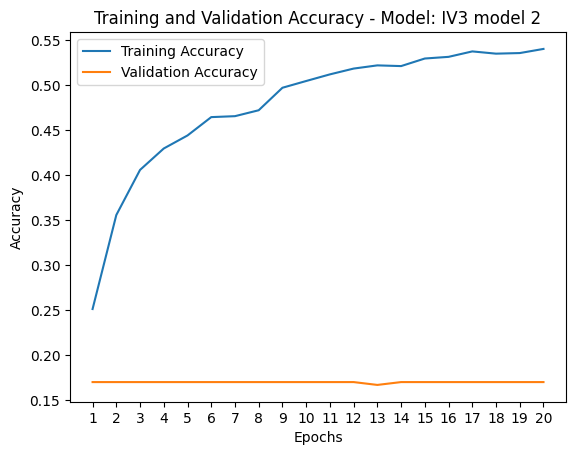

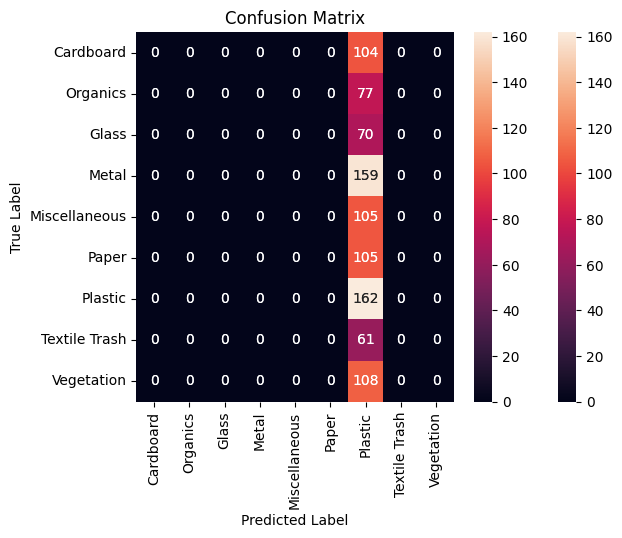

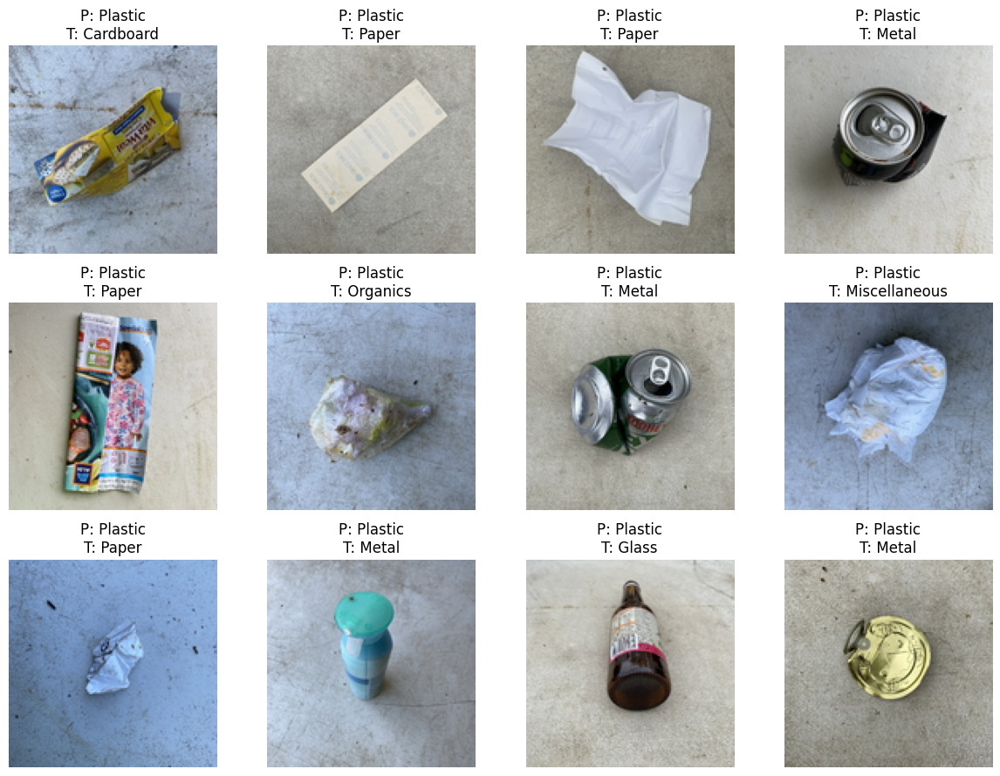

In [48]:
model_evaluation(IV3_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [49]:
# tinkering with the Dense layers
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_3 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_3.layers:
    layer.trainable = False


# flatten, add final dense layer, add softmax layer
    
IV3_model_3.add(Flatten())
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(512, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dropout(0.1))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dropout(0.1))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(9, activation='softmax'))

IV3_model_3.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 1024)              8389632   
                                                                 
 dense_1 (Dense)             (None, 1024)              1049600   
                                                                 
 dense_2 (Dense)             (None, 1024)              1049600   
                                                                 
 dense_3 (Dense)             (None, 1024)              1049600   
                                                                 
 dense_4 (Dense)             (None, 512)               5

In [50]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_3.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_3 = CNNModel(IV3_model_3, "IV3 model 3")
IV3_3.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 9s 13ms/step - loss: 2.4755 - accuracy: 0.1953 - val_loss: 2.1354 - val_accuracy: 0.1872
Epoch 2/20
476/476 [==============================] - 6s 12ms/step - loss: 1.9550 - accuracy: 0.2423 - val_loss: 2.1684 - val_accuracy: 0.1725
Epoch 3/20
476/476 [==============================] - 6s 12ms/step - loss: 1.8757 - accuracy: 0.2680 - val_loss: 2.2837 - val_accuracy: 0.1703
Epoch 4/20
476/476 [==============================] - 6s 12ms/step - loss: 1.8327 - accuracy: 0.2911 - val_loss: 2.2015 - val_accuracy: 0.1598
Epoch 5/20
476/476 [==============================] - 6s 12ms/step - loss: 1.7773 - accuracy: 0.2974 - val_loss: 2.1326 - val_accuracy: 0.1661
Epoch 6/20
476/476 [==============================] - 6s 12ms/step - loss: 1.7287 - accuracy: 0.3131 - val_loss: 2.1312 - val_accuracy: 0.1767
Epoch 7/20
476/476 [==============================] - 6s 12ms/step - loss: 1.7429 - accuracy: 0.3143 - val_loss: 2.1568 - val_accuracy: 0.1703

In [ ]:
model_evaluation(IV3_3, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [52]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_4 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_4.layers:
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
    
IV3_model_4.add(Flatten())    
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dropout(0.4))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dropout(0.2))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(9, activation='softmax'))

IV3_model_4.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 1024)              8389632   
                                                                 
 dense_1 (Dense)             (None, 1024)              1049600   
                                                                 
 dense_2 (Dense)             (None, 1024)              1049600   
                                                                 
 dense_3 (Dense)             (None, 1024)              1049600   
                                                                 
 dropout (Dropout)           (None, 1024)              0

### 

In [ ]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_4.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_4 = CNNModel(IV3_model_4, "IV3 model 4")
IV3_4.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

30/30 [==============================] - 1s 8ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.08      0.06      0.07        77
        Glass       0.00      0.00      0.00        70
        Metal       0.20      0.79      0.33       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.33      0.57      0.42       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.23       951
    macro avg       0.07      0.16      0.09       951
 weighted avg       0.10      0.23      0.13       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


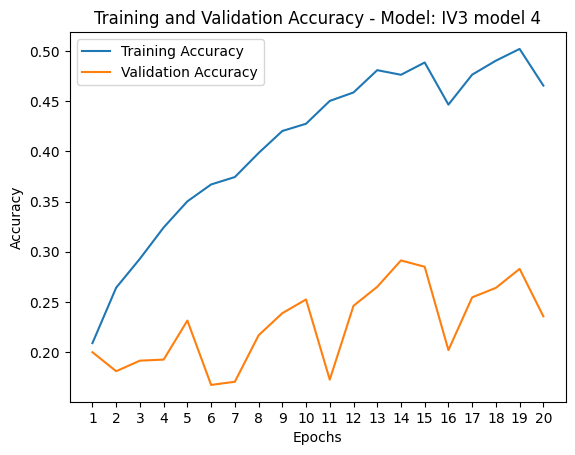

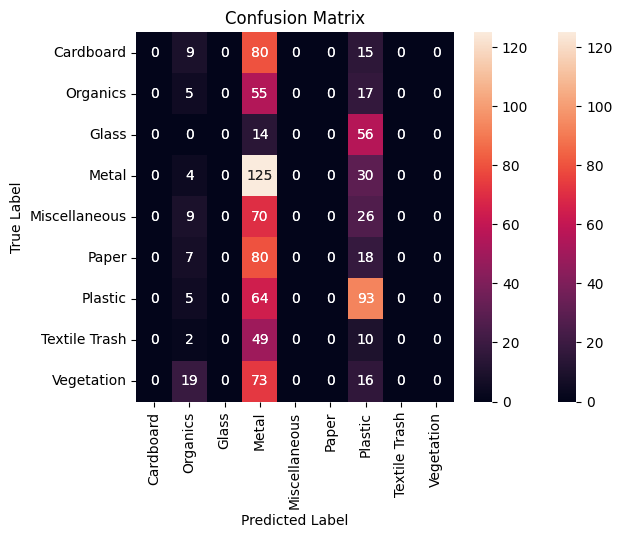

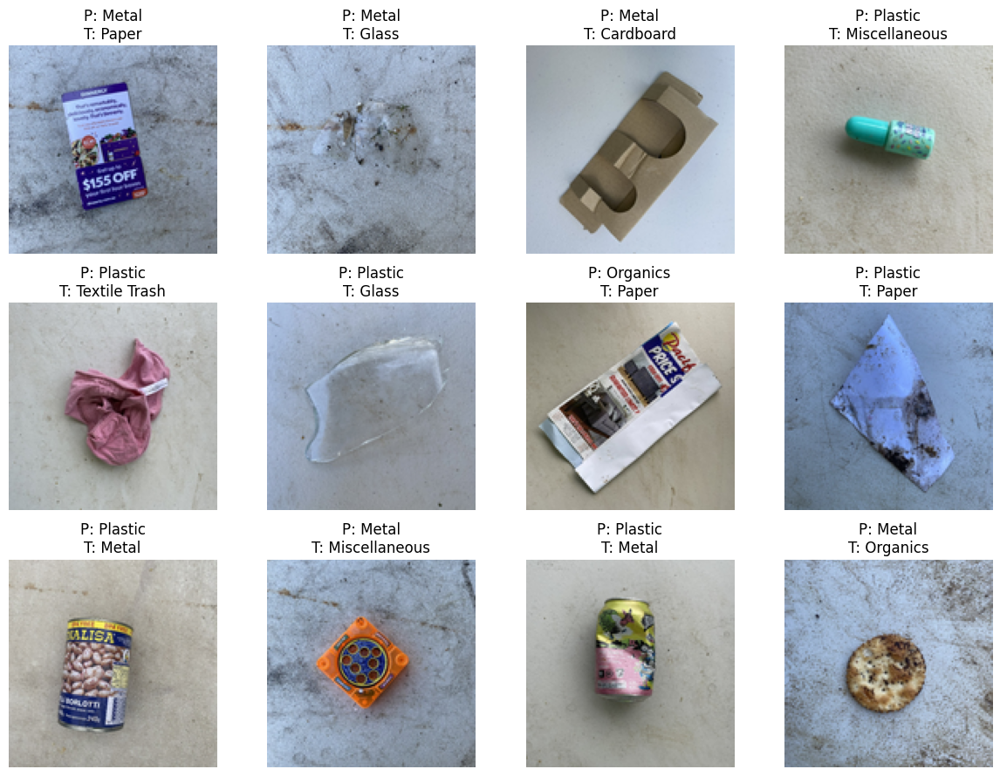

In [54]:
model_evaluation(IV3_4, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [55]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_5 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_5.layers:
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
    
IV3_model_5.add(Flatten())    
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dropout(0.4))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dropout(0.2))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(1024, activation='relu'))
IV3_model_5.add(Dense(1024, activation='relu'))
IV3_model_5.add(Dropout(0.2))
IV3_model_5.add(Dense(9, activation='softmax'))

IV3_model_5.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 2048)              16779264  
                                                                 
 dense_1 (Dense)             (None, 2048)              4196352   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense_2 (Dense)             (None, 2048)              4196352   
                                                                 
 dense_3 (Dense)             (None, 2048)              4

In [56]:
tf.keras.backend.clear_session()
IV3_model_5.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_5 = CNNModel(IV3_model_5, "IV3 model 5")
IV3_5.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 15s 26ms/step - loss: 5.2617 - accuracy: 0.1994 - val_loss: 2.1474 - val_accuracy: 0.1714
Epoch 2/20
476/476 [==============================] - 12s 25ms/step - loss: 2.0102 - accuracy: 0.2290 - val_loss: 2.1429 - val_accuracy: 0.1703
Epoch 3/20
476/476 [==============================] - 12s 25ms/step - loss: 1.9428 - accuracy: 0.2511 - val_loss: 2.1657 - val_accuracy: 0.1703
Epoch 4/20
476/476 [==============================] - 12s 25ms/step - loss: 1.8964 - accuracy: 0.2615 - val_loss: 2.1398 - val_accuracy: 0.1725
Epoch 5/20
476/476 [==============================] - 12s 25ms/step - loss: 1.8350 - accuracy: 0.2836 - val_loss: 2.2223 - val_accuracy: 0.1682
Epoch 6/20
476/476 [==============================] - 12s 25ms/step - loss: 1.7971 - accuracy: 0.2994 - val_loss: 2.3323 - val_accuracy: 0.1693
Epoch 7/20
476/476 [==============================] - 12s 25ms/step - loss: 1.7675 - accuracy: 0.3057 - val_loss: 2.1435 - val_accuracy:

30/30 [==============================] - 1s 11ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.13      0.10      0.12        77
        Glass       0.00      0.00      0.00        70
        Metal       0.09      0.04      0.06       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.19      0.85      0.32       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.46      0.43      0.44       108

     accuracy                           0.21       951
    macro avg       0.10      0.16      0.10       951
 weighted avg       0.11      0.21      0.12       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


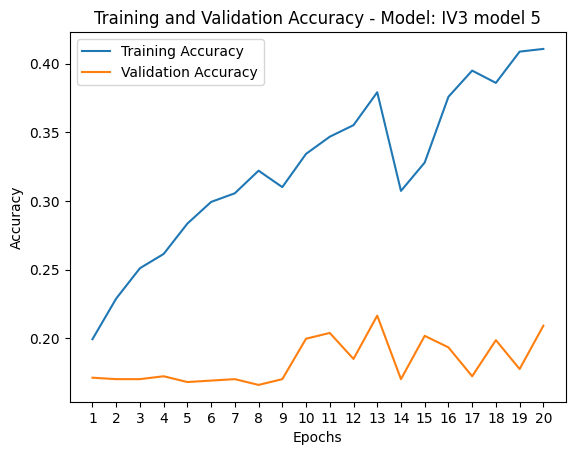

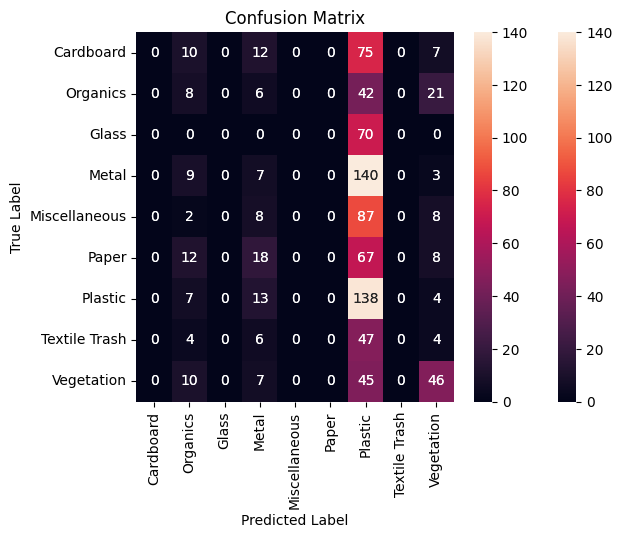

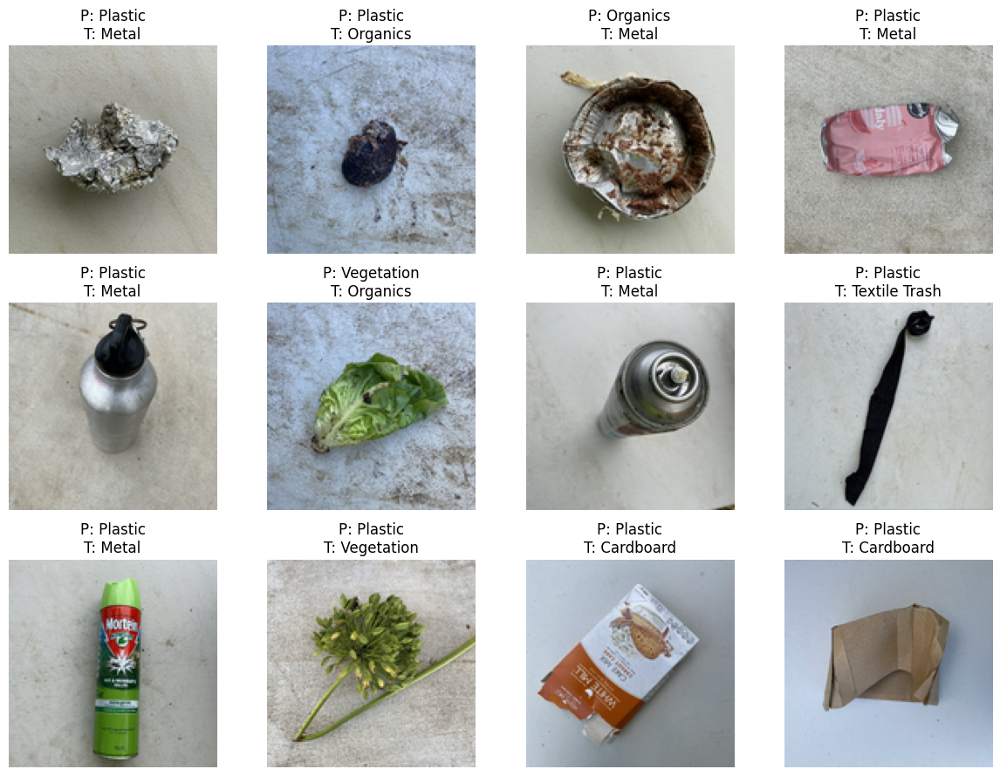

In [57]:
model_evaluation(IV3_5, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [58]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_6 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_6.layers:   # <====== MISSED THIS!!
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
IV3_model_6.add(Flatten())    
IV3_model_6.add(Dense(512, activation='relu'))
IV3_model_6.add(Dense(1024, activation='relu'))
IV3_model_6.add(Dense(512, activation='relu'))
IV3_model_6.add(Dropout(0.2))
IV3_model_6.add(Dense(512, activation='relu'))
IV3_model_6.add(Dense(256, activation='relu'))
IV3_model_6.add(Dropout(0.2))
IV3_model_6.add(Dense(9, activation='softmax'))

IV3_model_6.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 512)               4194816   
                                                                 
 dense_1 (Dense)             (None, 1024)              525312    
                                                                 
 dense_2 (Dense)             (None, 512)               524800    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 512)               2

In [61]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_6.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_6 = CNNModel(IV3_model_6, "IV3 model 6")
IV3_6.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 8s 12ms/step - loss: 1.4834 - accuracy: 0.4728 - val_loss: 2.1625 - val_accuracy: 0.1703
Epoch 2/20
476/476 [==============================] - 6s 13ms/step - loss: 1.4222 - accuracy: 0.4834 - val_loss: 2.1617 - val_accuracy: 0.1703
Epoch 3/20
476/476 [==============================] - 6s 12ms/step - loss: 1.4070 - accuracy: 0.4896 - val_loss: 2.1619 - val_accuracy: 0.1703
Epoch 4/20
476/476 [==============================] - 6s 12ms/step - loss: 1.4135 - accuracy: 0.4849 - val_loss: 2.1619 - val_accuracy: 0.1703
Epoch 5/20
476/476 [==============================] - 6s 12ms/step - loss: 1.3902 - accuracy: 0.4958 - val_loss: 2.1596 - val_accuracy: 0.1703
Epoch 6/20
476/476 [==============================] - 6s 12ms/step - loss: 1.3660 - accuracy: 0.5053 - val_loss: 2.1622 - val_accuracy: 0.1703
Epoch 7/20
476/476 [==============================] - 6s 12ms/step - loss: 1.3622 - accuracy: 0.5041 - val_loss: 2.1654 - val_accuracy: 0.1703

30/30 [==============================] - 1s 9ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


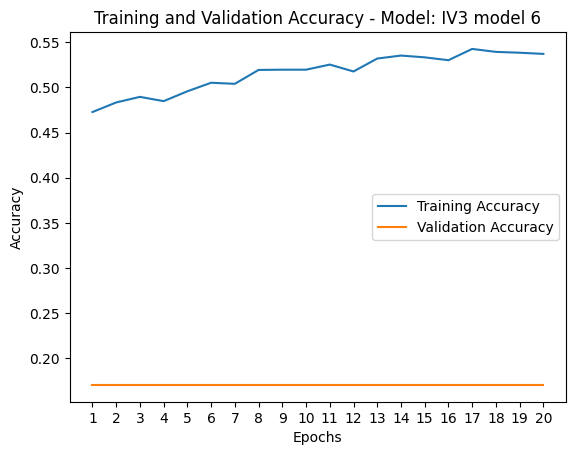

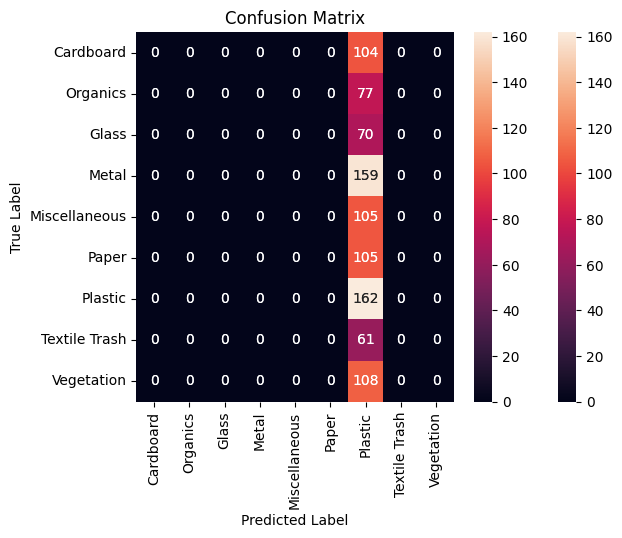

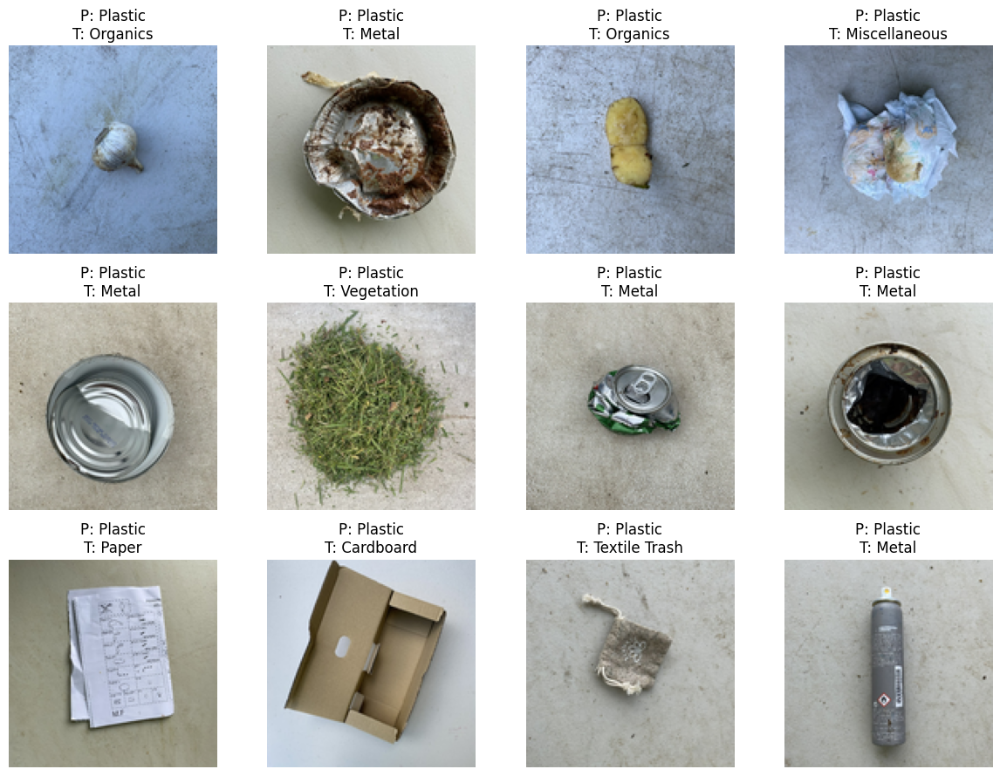

In [62]:
model_evaluation(IV3_6, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [63]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_7 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_7.layers:
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
IV3_model_7.add(Flatten())    
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dropout(0.2))
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dropout(0.2))
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dense(9, activation='softmax'))

IV3_model_7.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 512)               4194816   
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dense_2 (Dense)             (None, 512)               131584    
                                                                 
 dense_3 (Dense)             (None, 256)               131328    
                                                                 
 dropout (Dropout)           (None, 256)               0

In [65]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_7.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_7 = CNNModel(IV3_model_7, "IV3 model 7")
IV3_7.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 9s 14ms/step - loss: 2.6397 - accuracy: 0.1810 - val_loss: 2.0905 - val_accuracy: 0.1746
Epoch 2/20
476/476 [==============================] - 6s 12ms/step - loss: 1.9992 - accuracy: 0.2345 - val_loss: 2.0678 - val_accuracy: 0.2135
Epoch 3/20
476/476 [==============================] - 6s 12ms/step - loss: 1.8712 - accuracy: 0.2752 - val_loss: 2.0928 - val_accuracy: 0.1977
Epoch 4/20
476/476 [==============================] - 6s 12ms/step - loss: 1.8030 - accuracy: 0.2947 - val_loss: 2.0714 - val_accuracy: 0.1924
Epoch 5/20
476/476 [==============================] - 6s 12ms/step - loss: 1.7216 - accuracy: 0.3357 - val_loss: 2.0516 - val_accuracy: 0.2766
Epoch 6/20
476/476 [==============================] - 6s 12ms/step - loss: 1.6594 - accuracy: 0.3656 - val_loss: 2.0224 - val_accuracy: 0.2524
Epoch 7/20
476/476 [==============================] - 5s 11ms/step - loss: 1.6179 - accuracy: 0.3745 - val_loss: 2.0488 - val_accuracy: 0.2072

30/30 [==============================] - 1s 9ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.23      0.66      0.34        77
        Glass       0.82      0.33      0.47        70
        Metal       0.31      0.55      0.40       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.50      0.19      0.28       105
      Plastic       0.26      0.59      0.36       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.29       951
    macro avg       0.23      0.26      0.20       951
 weighted avg       0.23      0.29      0.22       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


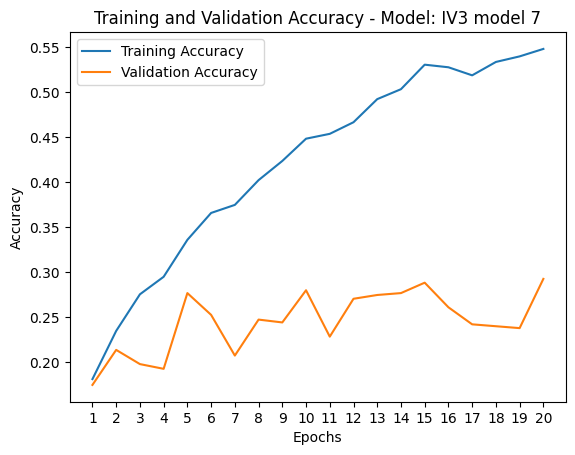

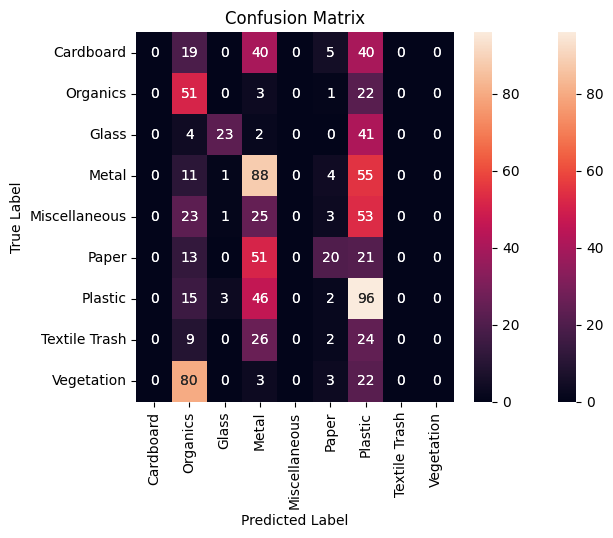

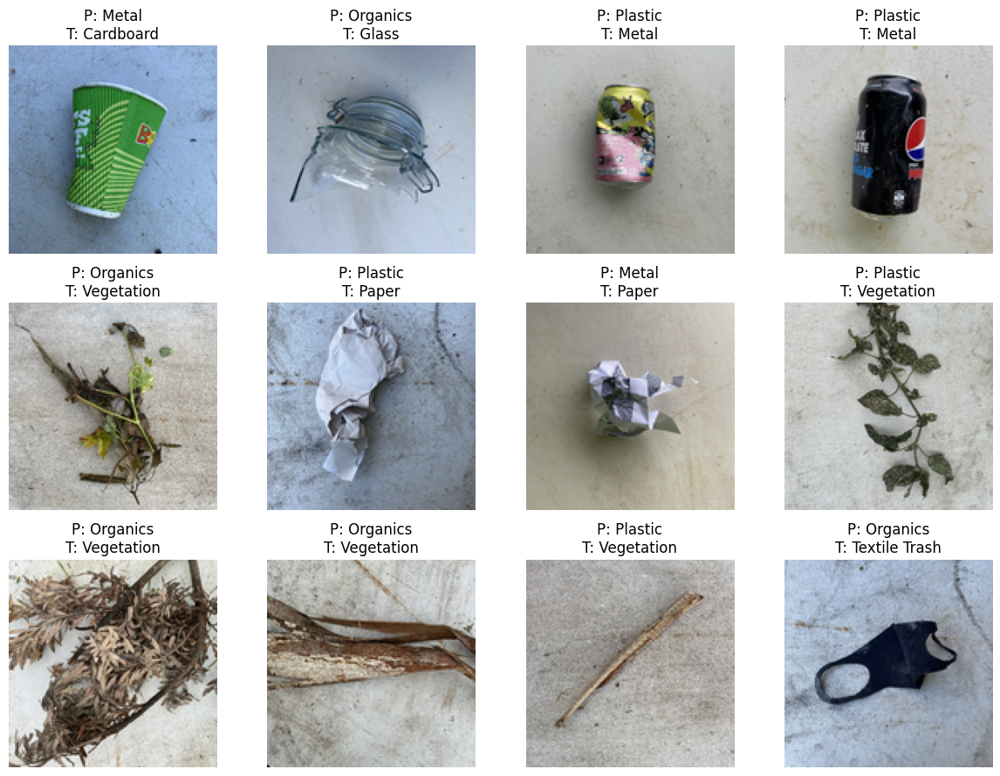

In [66]:
model_evaluation(IV3_7, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

## ResNet50

In [23]:
input_t = Input(shape=(131, 131, 3))
RN50 = ResNet50(include_top=False, weights="imagenet", input_tensor=input_t)
RN_model_1 = Sequential([RN50])

for layer in RN_model_1.layers[:-1]:     # one example suggested leaving the last layer trainable, maybe try on IV3
    layer.trainable = False
    
RN_model_1.add(Flatten())    
RN_model_1.add(Dense(1024, activation='relu'))
RN_model_1.add(Dense(512, activation='relu'))
RN_model_1.add(Dropout(0.2))
RN_model_1.add(Dense(256, activation='relu'))
RN_model_1.add(Dense(9, activation='softmax'))

RN_model_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 dense (Dense)               (None, 1024)              52429824  
                                                                 
 dense_1 (Dense)             (None, 512)               524800    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 256)               131328    
                                                                 
 dense_3 (Dense)             (None, 9)                 2

In [24]:
gc.collect()
tf.keras.backend.clear_session()
RN_model_1.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
RN_1 = CNNModel(RN_model_1, "ResNet50 model 1")
RN_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20


2025-08-12 16:55:02.159835: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8906


  1/476 [..............................] - ETA: 1:20:11 - loss: 3.6406 - accuracy: 0.0000e+00

2025-08-12 16:55:03.182494: I external/local_xla/xla/service/service.cc:168] XLA service 0x78fb89a7e2b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-08-12 16:55:03.182520: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2025-08-12 16:55:03.186618: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1755017703.232561   42661 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


476/476 [==============================] - 46s 75ms/step - loss: 2.2423 - accuracy: 0.2427 - val_loss: 214.0511 - val_accuracy: 0.1746
Epoch 2/20
476/476 [==============================] - 29s 60ms/step - loss: 1.9642 - accuracy: 0.2818 - val_loss: 1.7511 - val_accuracy: 0.3828
Epoch 3/20
476/476 [==============================] - 28s 59ms/step - loss: 1.8641 - accuracy: 0.3165 - val_loss: 1.7437 - val_accuracy: 0.3764
Epoch 4/20
476/476 [==============================] - 27s 57ms/step - loss: 1.7811 - accuracy: 0.3390 - val_loss: 1.7190 - val_accuracy: 0.3764
Epoch 5/20
476/476 [==============================] - 26s 54ms/step - loss: 1.7626 - accuracy: 0.3517 - val_loss: 1.6363 - val_accuracy: 0.4564
Epoch 6/20
476/476 [==============================] - 26s 54ms/step - loss: 1.7140 - accuracy: 0.3652 - val_loss: 1.3147 - val_accuracy: 0.5468
Epoch 7/20
476/476 [==============================] - 26s 54ms/step - loss: 1.7939 - accuracy: 0.3446 - val_loss: 1.3971 - val_accuracy: 0.5237
E

30/30 [==============================] - 1s 14ms/step
               precision    recall  f1-score   support

    Cardboard       0.77      0.67      0.72       104
     Organics       0.59      0.84      0.70        77
        Glass       0.98      0.69      0.81        70
        Metal       0.78      0.56      0.65       159
Miscellaneous       0.46      0.37      0.41       105
        Paper       0.60      0.72      0.66       105
      Plastic       0.62      0.72      0.67       162
Textile Trash       0.40      0.54      0.46        61
   Vegetation       0.80      0.78      0.79       108

     accuracy                           0.65       951
    macro avg       0.67      0.66      0.65       951
 weighted avg       0.67      0.65      0.65       951



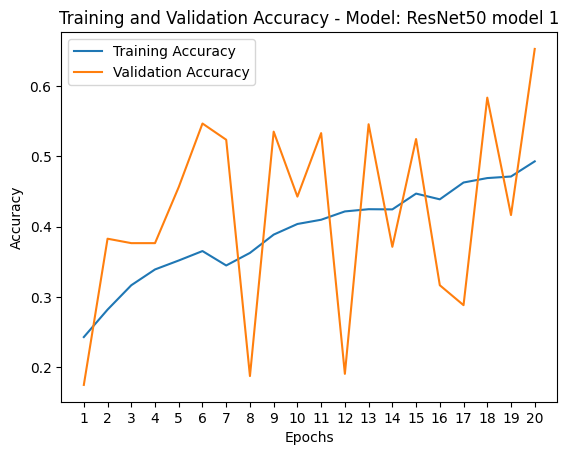

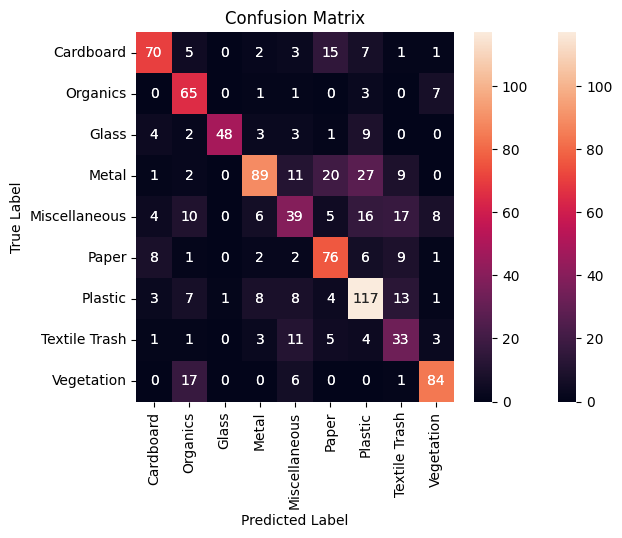

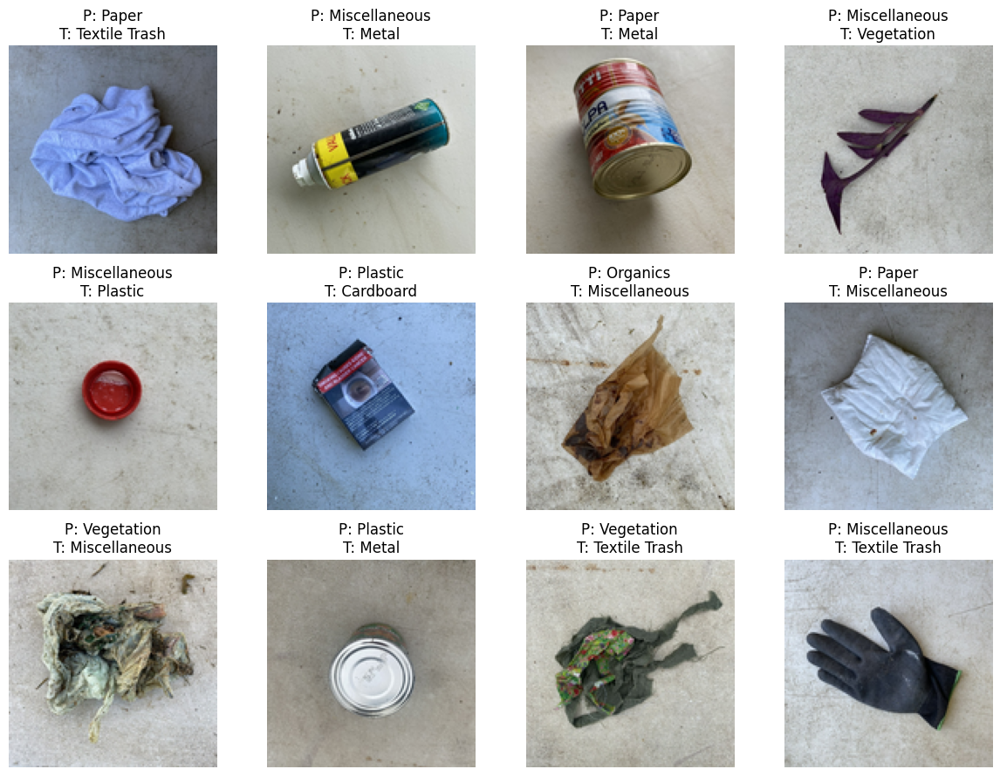

In [25]:
model_evaluation(RN_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

This is interesting.  The accuracy of 0.65 is the best yet, and the confusion matrix shows that it has some skill in identifying each category.  However, the extreme volatility of the validation accuracy is concerning - it's bouncing all over the place.  I'd like to understand what this means.  Why it's happening, and what the implications could be for the reliability of such a model.

In [26]:
# RN50 is proving more productive than IV3

input_t = Input(shape=(131, 131, 3))
RN50 = ResNet50(include_top=False, weights="imagenet", input_tensor=input_t)
RN_model_2 = Sequential([RN50])

for layer in RN_model_2.layers:    
    layer.trainable = False
    
RN_model_2.add(Flatten())    
RN_model_2.add(Dense(1024, activation='relu'))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dropout(0.2))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dropout(0.2))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dense(9, activation='softmax'))

RN_model_2.summary()    

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 dense (Dense)               (None, 1024)              52429824  
                                                                 
 dense_1 (Dense)             (None, 512)               524800    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 512)               262656    
                                                                 
 dense_3 (Dense)             (None, 512)               2

In [28]:
gc.collect()
tf.keras.backend.clear_session()
RN_model_2.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
RN_2 = CNNModel(RN_model_2, "ResNet50 model 2")
RN_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 22s 41ms/step - loss: 1.7983 - accuracy: 0.3404 - val_loss: 1.3260 - val_accuracy: 0.5899
Epoch 2/20
476/476 [==============================] - 19s 40ms/step - loss: 1.5347 - accuracy: 0.4553 - val_loss: 0.9378 - val_accuracy: 0.6814
Epoch 3/20
476/476 [==============================] - 19s 40ms/step - loss: 1.4054 - accuracy: 0.5013 - val_loss: 0.9830 - val_accuracy: 0.7014
Epoch 4/20
476/476 [==============================] - 19s 40ms/step - loss: 1.3092 - accuracy: 0.5333 - val_loss: 1.0217 - val_accuracy: 0.7014
Epoch 5/20
476/476 [==============================] - 19s 40ms/step - loss: 1.1994 - accuracy: 0.5756 - val_loss: 1.1795 - val_accuracy: 0.7098
Epoch 6/20
476/476 [==============================] - 20s 41ms/step - loss: 1.2017 - accuracy: 0.5714 - val_loss: 0.9265 - val_accuracy: 0.7624
Epoch 7/20
476/476 [==============================] - 19s 40ms/step - loss: 1.1612 - accuracy: 0.5851 - val_loss: 1.1580 - val_accuracy:

30/30 [==============================] - 1s 14ms/step
               precision    recall  f1-score   support

    Cardboard       0.91      0.71      0.80       104
     Organics       0.91      0.55      0.68        77
        Glass       0.83      0.84      0.84        70
        Metal       0.57      0.95      0.72       159
Miscellaneous       0.56      0.59      0.58       105
        Paper       0.74      0.84      0.79       105
      Plastic       0.85      0.58      0.69       162
Textile Trash       0.80      0.67      0.73        61
   Vegetation       0.95      0.87      0.91       108

     accuracy                           0.74       951
    macro avg       0.79      0.73      0.75       951
 weighted avg       0.78      0.74      0.74       951



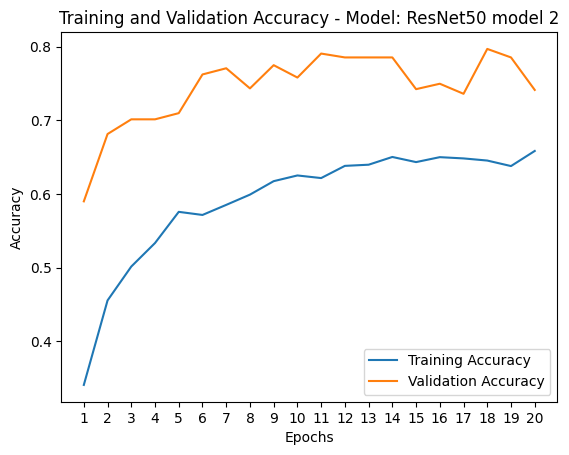

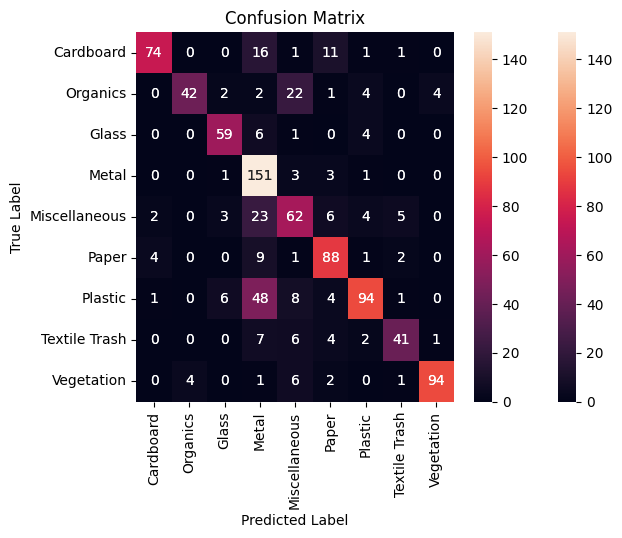

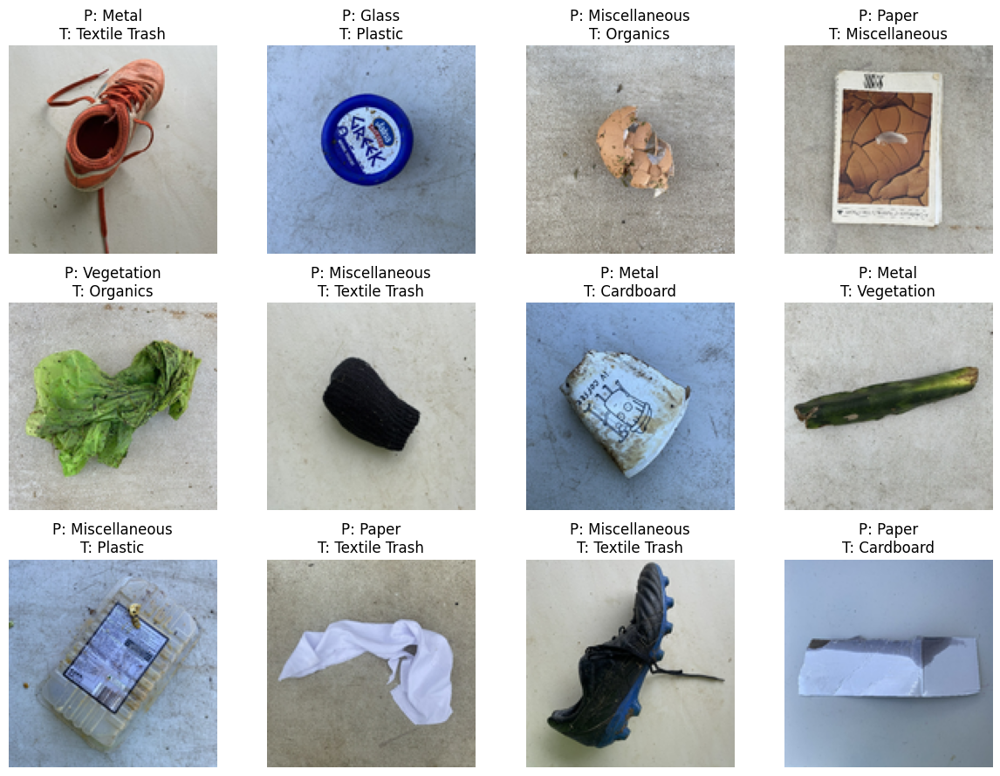

In [29]:
model_evaluation(RN_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

## DenseNet-121

In [30]:
input_t = Input(shape=(131, 131, 3))
DN121 = DenseNet121(include_top=False, weights="imagenet", input_tensor=input_t)

DN_model_1 = Sequential([RN50])

for layer in DN_model_1.layers:     
    layer.trainable = False
    
DN_model_1.add(Flatten())    
DN_model_1.add(Dense(1024, activation='relu'))
DN_model_1.add(Dense(512, activation='relu'))
DN_model_1.add(Dense(1024, activation='relu'))
DN_model_1.add(Dropout(0.2))
DN_model_1.add(Dense(512, activation='relu'))
DN_model_1.add(Dense(9, activation='softmax'))

DN_model_1.summary()  

29084464/29084464 [==============================] - 2s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 dense (Dense)               (None, 1024)              52429824  
                                                                 
 dense_1 (Dense)             (None, 512)               524800    
                                                                 
 dense_2 (Dense)             (None, 1024)              525312    
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                         

In [31]:
gc.collect()
tf.keras.backend.clear_session()
DN_model_1.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
DN_1 = CNNModel(DN_model_1, "DenseNet-121 model 1")
DN_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 22s 43ms/step - loss: 2.1454 - accuracy: 0.3727 - val_loss: 0.9944 - val_accuracy: 0.6477
Epoch 2/20
476/476 [==============================] - 20s 41ms/step - loss: 1.4401 - accuracy: 0.4796 - val_loss: 0.9575 - val_accuracy: 0.6898
Epoch 3/20
476/476 [==============================] - 20s 41ms/step - loss: 1.3138 - accuracy: 0.5155 - val_loss: 0.7597 - val_accuracy: 0.7581
Epoch 4/20
476/476 [==============================] - 20s 41ms/step - loss: 1.2315 - accuracy: 0.5526 - val_loss: 0.8181 - val_accuracy: 0.7750
Epoch 5/20
476/476 [==============================] - 20s 41ms/step - loss: 1.1935 - accuracy: 0.5651 - val_loss: 1.4595 - val_accuracy: 0.6803
Epoch 6/20
476/476 [==============================] - 20s 41ms/step - loss: 1.1384 - accuracy: 0.5839 - val_loss: 1.0616 - val_accuracy: 0.7708
Epoch 7/20
476/476 [==============================] - 20s 41ms/step - loss: 1.1244 - accuracy: 0.5917 - val_loss: 1.7903 - val_accuracy:

30/30 [==============================] - 1s 14ms/step
               precision    recall  f1-score   support

    Cardboard       0.79      0.85      0.81       104
     Organics       0.90      0.84      0.87        77
        Glass       0.77      0.83      0.80        70
        Metal       0.77      0.87      0.82       159
Miscellaneous       0.72      0.67      0.69       105
        Paper       0.84      0.78      0.81       105
      Plastic       0.79      0.73      0.76       162
Textile Trash       0.78      0.74      0.76        61
   Vegetation       0.92      0.94      0.93       108

     accuracy                           0.81       951
    macro avg       0.81      0.80      0.81       951
 weighted avg       0.81      0.81      0.80       951



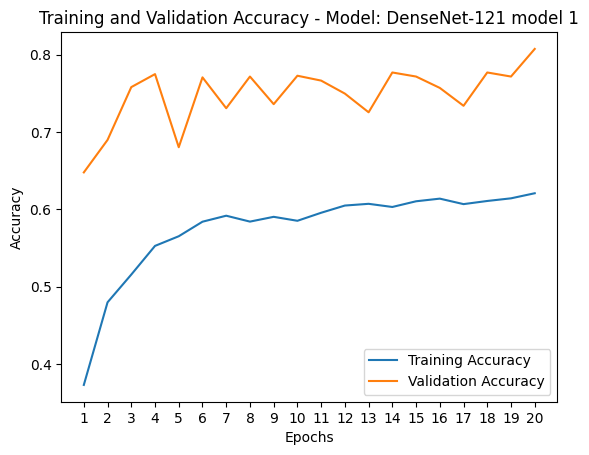

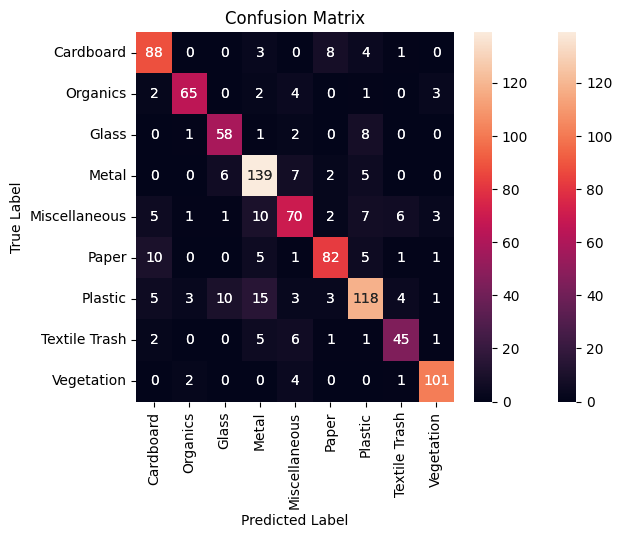

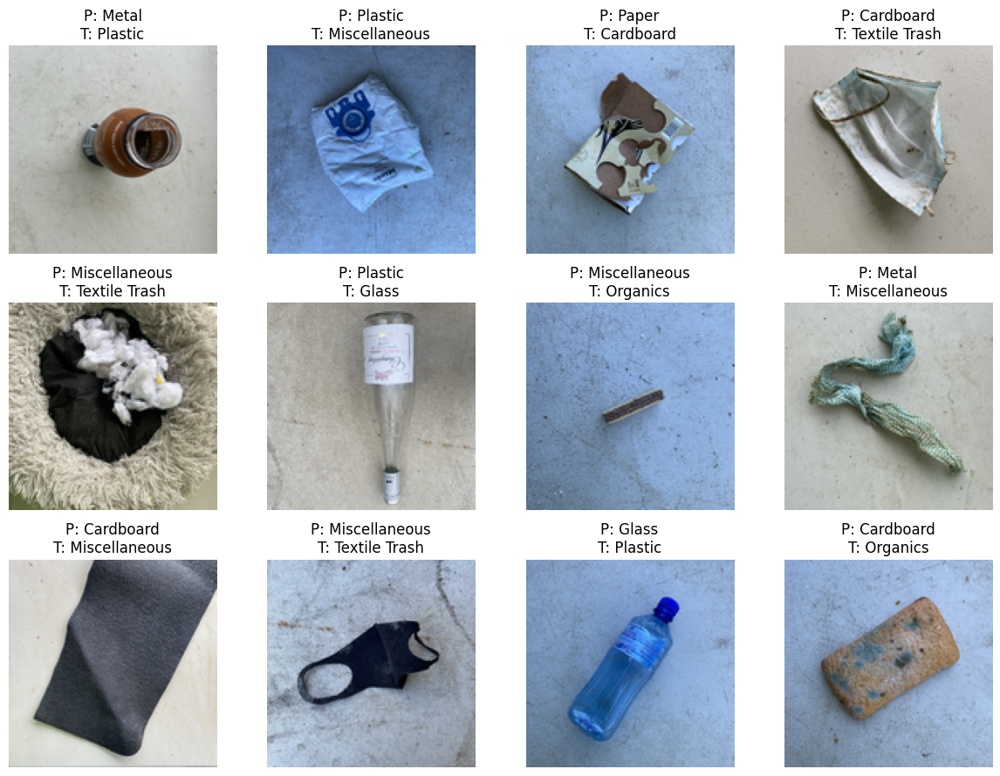

In [32]:
model_evaluation(DN_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [33]:
input_t = Input(shape=(131, 131, 3))
DN121 = DenseNet121(include_top=False, weights="imagenet", input_tensor=input_t)

DN_model_2 = Sequential([RN50])

for layer in DN_model_2.layers:     
    layer.trainable = False
    
DN_model_2.add(Flatten())    
DN_model_2.add(Dense(512, activation='relu'))
DN_model_2.add(Dense(256, activation='relu'))
DN_model_2.add(Dense(512, activation='relu'))
DN_model_2.add(Dropout(0.2))
DN_model_2.add(Dense(256, activation='relu'))
DN_model_2.add(Dense(512, activation='relu'))
DN_model_2.add(Dropout(0.2))
DN_model_2.add(Dense(256, activation='relu'))
DN_model_2.add(Dense(9, activation='softmax'))

DN_model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 dense (Dense)               (None, 512)               26214912  
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dense_2 (Dense)             (None, 512)               131584    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 256)               1

In [35]:
gc.collect()
tf.keras.backend.clear_session()
DN_model_2.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
DN_2 = CNNModel(DN_model_2, "DenseNet-121 model 2")
DN_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 11s 19ms/step - loss: 1.9303 - accuracy: 0.3236 - val_loss: 1.1200 - val_accuracy: 0.5994
Epoch 2/20
476/476 [==============================] - 8s 18ms/step - loss: 1.5238 - accuracy: 0.4494 - val_loss: 0.8876 - val_accuracy: 0.7319
Epoch 3/20
476/476 [==============================] - 8s 18ms/step - loss: 1.3708 - accuracy: 0.5038 - val_loss: 0.8794 - val_accuracy: 0.7308
Epoch 4/20
476/476 [==============================] - 8s 17ms/step - loss: 1.2589 - accuracy: 0.5468 - val_loss: 1.1103 - val_accuracy: 0.7245
Epoch 5/20
476/476 [==============================] - 8s 17ms/step - loss: 1.2174 - accuracy: 0.5587 - val_loss: 0.9632 - val_accuracy: 0.7655
Epoch 6/20
476/476 [==============================] - 8s 18ms/step - loss: 1.1644 - accuracy: 0.5802 - val_loss: 1.0254 - val_accuracy: 0.7697
Epoch 7/20
476/476 [==============================] - 8s 18ms/step - loss: 1.1387 - accuracy: 0.5897 - val_loss: 1.3488 - val_accuracy: 0.735

30/30 [==============================] - 1s 11ms/step
               precision    recall  f1-score   support

    Cardboard       0.87      0.72      0.79       104
     Organics       0.88      0.77      0.82        77
        Glass       0.93      0.71      0.81        70
        Metal       0.63      0.91      0.74       159
Miscellaneous       0.82      0.50      0.62       105
        Paper       0.82      0.65      0.72       105
      Plastic       0.62      0.77      0.69       162
Textile Trash       0.72      0.69      0.71        61
   Vegetation       0.95      0.95      0.95       108

     accuracy                           0.75       951
    macro avg       0.80      0.74      0.76       951
 weighted avg       0.78      0.75      0.75       951



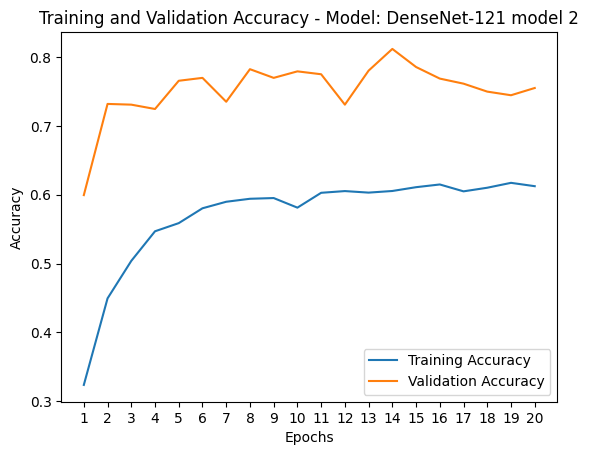

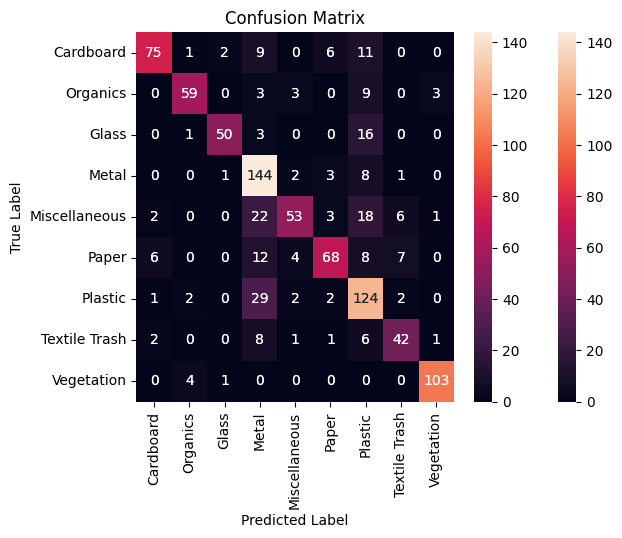

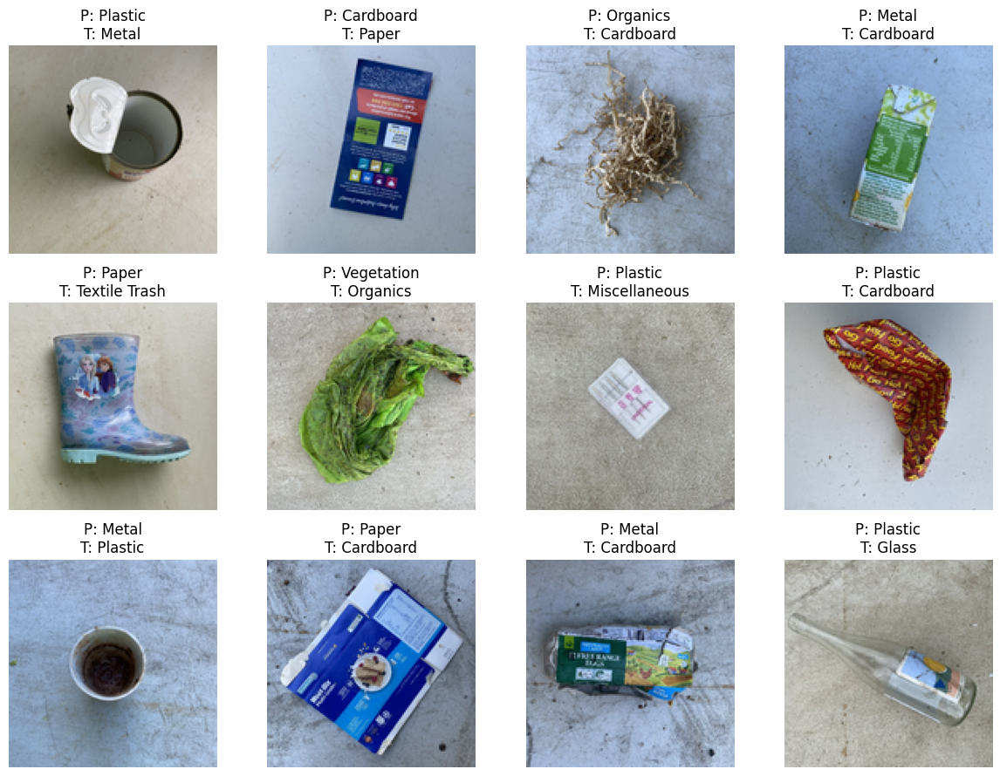

In [36]:
model_evaluation(DN_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

# EfficientNet-B0

In [37]:
input_t = Input(shape=(131, 131, 3))
ENB0 = EfficientNetB0(include_top=False, weights="imagenet", input_tensor=input_t)

EN_model_1 = Sequential([ENB0])

for layer in EN_model_1.layers:     
    layer.trainable = False
    
EN_model_1.add(Flatten())    
EN_model_1.add(Dense(1024, activation='relu'))
EN_model_1.add(Dense(512, activation='relu'))
EN_model_1.add(Dense(1024, activation='relu'))
EN_model_1.add(Dropout(0.2))
EN_model_1.add(Dense(512, activation='relu'))
EN_model_1.add(Dense(9, activation='softmax'))

EN_model_1.summary()

16705208/16705208 [==============================] - 2s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb0 (Functional  (None, 5, 5, 1280)        4049571   
 )                                                               
                                                                 
 flatten (Flatten)           (None, 32000)             0         
                                                                 
 dense (Dense)               (None, 1024)              32769024  
                                                                 
 dense_1 (Dense)             (None, 512)               524800    
                                                                 
 dense_2 (Dense)             (None, 1024)              525312    
                                                                 
 dropout (Dropout)           (None, 1024)              0 

In [38]:
gc.collect()
tf.keras.backend.clear_session()
EN_model_1.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
EN_1 = CNNModel(EN_model_1, "EfficientNet-B0 model 1")
EN_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 14s 23ms/step - loss: 1.8042 - accuracy: 0.3844 - val_loss: 0.8382 - val_accuracy: 0.7340
Epoch 2/20
476/476 [==============================] - 11s 23ms/step - loss: 1.4255 - accuracy: 0.4853 - val_loss: 0.7247 - val_accuracy: 0.7834
Epoch 3/20
476/476 [==============================] - 11s 23ms/step - loss: 1.3108 - accuracy: 0.5207 - val_loss: 0.6921 - val_accuracy: 0.7729
Epoch 4/20
476/476 [==============================] - 11s 23ms/step - loss: 1.2616 - accuracy: 0.5384 - val_loss: 0.7441 - val_accuracy: 0.7907
Epoch 5/20
476/476 [==============================] - 11s 23ms/step - loss: 1.2050 - accuracy: 0.5599 - val_loss: 0.6293 - val_accuracy: 0.8297
Epoch 6/20
476/476 [==============================] - 11s 23ms/step - loss: 1.2094 - accuracy: 0.5597 - val_loss: 0.6228 - val_accuracy: 0.8423
Epoch 7/20
476/476 [==============================] - 11s 23ms/step - loss: 1.1869 - accuracy: 0.5691 - val_loss: 0.6949 - val_accuracy:

30/30 [==============================] - 1s 9ms/step
               precision    recall  f1-score   support

    Cardboard       0.79      0.80      0.79       104
     Organics       0.86      0.88      0.87        77
        Glass       0.87      0.89      0.88        70
        Metal       0.77      0.89      0.83       159
Miscellaneous       0.75      0.67      0.71       105
        Paper       0.83      0.82      0.83       105
      Plastic       0.85      0.78      0.81       162
Textile Trash       0.75      0.74      0.74        61
   Vegetation       0.92      0.94      0.93       108

     accuracy                           0.82       951
    macro avg       0.82      0.82      0.82       951
 weighted avg       0.82      0.82      0.82       951



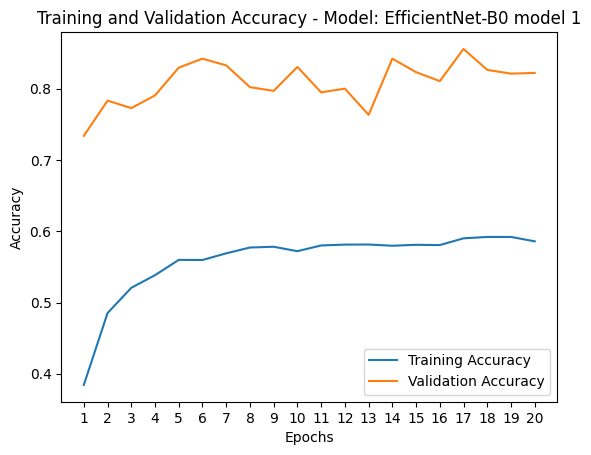

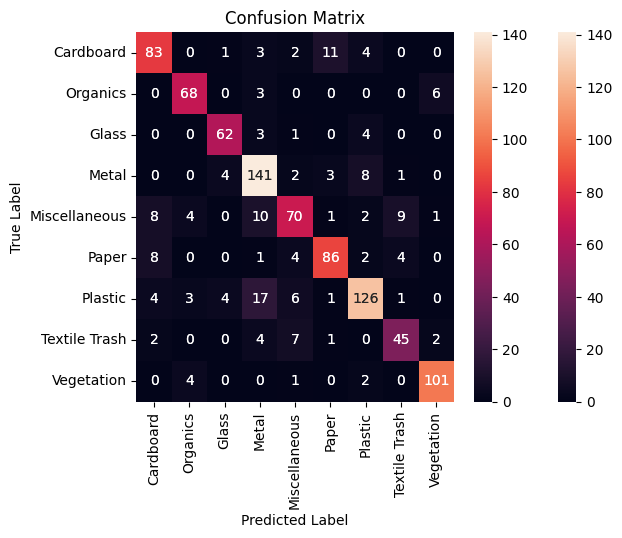

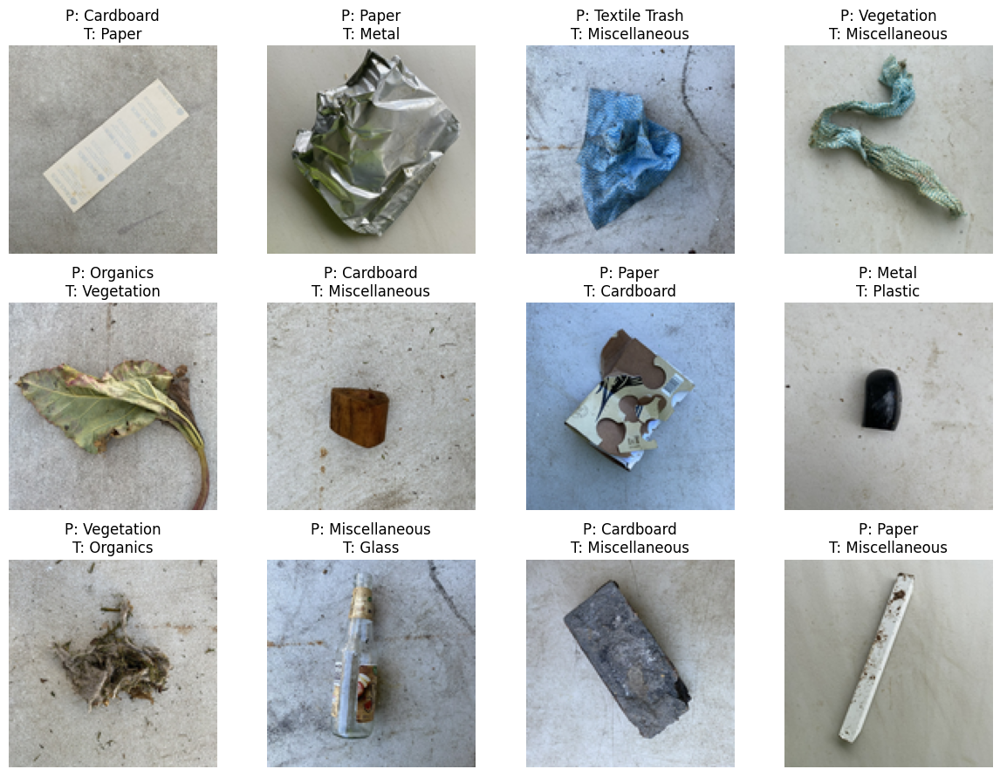

In [39]:
model_evaluation(EN_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [61]:
input_t = Input(shape=(131, 131, 3))
ENB0 = EfficientNetB0(include_top=False, weights="imagenet", input_tensor=input_t)

EN_model_2 = Sequential([ENB0])

for layer in EN_model_2.layers:     
    layer.trainable = False
    
EN_model_2.add(Flatten())    
EN_model_2.add(Dense(512, activation='relu'))
EN_model_2.add(Dense(1024, activation='relu'))
EN_model_2.add(Dense(512, activation='relu'))
EN_model_2.add(Dropout(0.2))
EN_model_2.add(Dense(512, activation='relu'))
EN_model_2.add(Dense(256, activation='relu'))
EN_model_2.add(Dropout(0.2))
EN_model_2.add(Dense(256, activation='relu'))
EN_model_2.add(Dense(9, activation='softmax'))

EN_model_2.summary()    

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb0 (Functional  (None, 5, 5, 1280)        4049571   
 )                                                               
                                                                 
 flatten (Flatten)           (None, 32000)             0         
                                                                 
 dense (Dense)               (None, 512)               16384512  
                                                                 
 dense_1 (Dense)             (None, 1024)              525312    
                                                                 
 dense_2 (Dense)             (None, 512)               524800    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                        

In [63]:
gc.collect()
tf.keras.backend.clear_session()
EN_model_2.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
EN_2 = CNNModel(EN_model_2, "EfficientNet-B0 model 2")
EN_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=4)

Epoch 1/20
1901/1901 [==============================] - 40s 19ms/step - loss: 1.9334 - accuracy: 0.3086 - val_loss: 1.1546 - val_accuracy: 0.6215
Epoch 2/20
1901/1901 [==============================] - 41s 22ms/step - loss: 1.6758 - accuracy: 0.4067 - val_loss: 1.1910 - val_accuracy: 0.5731
Epoch 3/20
1901/1901 [==============================] - 41s 22ms/step - loss: 1.5435 - accuracy: 0.4469 - val_loss: 1.0586 - val_accuracy: 0.6330
Epoch 4/20
1901/1901 [==============================] - 40s 21ms/step - loss: 1.5279 - accuracy: 0.4766 - val_loss: 1.3491 - val_accuracy: 0.7224
Epoch 5/20
1901/1901 [==============================] - 47s 25ms/step - loss: 1.4413 - accuracy: 0.4913 - val_loss: 0.8366 - val_accuracy: 0.7371
Epoch 6/20
1901/1901 [==============================] - 49s 26ms/step - loss: 1.4113 - accuracy: 0.5053 - val_loss: 1.7073 - val_accuracy: 0.7287
Epoch 7/20
1901/1901 [==============================] - 38s 20ms/step - loss: 1.4259 - accuracy: 0.5170 - val_loss: 1.5514 -

30/30 [==============================] - 1s 11ms/step
               precision    recall  f1-score   support

    Cardboard       0.82      0.87      0.84       104
     Organics       0.90      0.90      0.90        77
        Glass       1.00      0.53      0.69        70
        Metal       0.82      0.81      0.81       159
Miscellaneous       0.76      0.73      0.75       105
        Paper       0.82      0.85      0.84       105
      Plastic       0.64      0.85      0.73       162
Textile Trash       0.95      0.64      0.76        61
   Vegetation       0.91      0.88      0.90       108

     accuracy                           0.80       951
    macro avg       0.85      0.78      0.80       951
 weighted avg       0.82      0.80      0.80       951



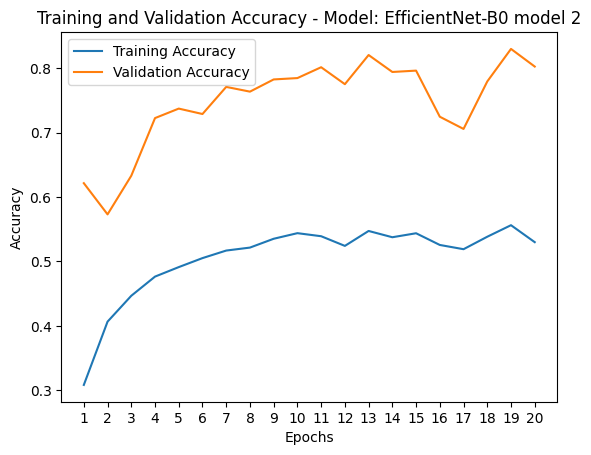

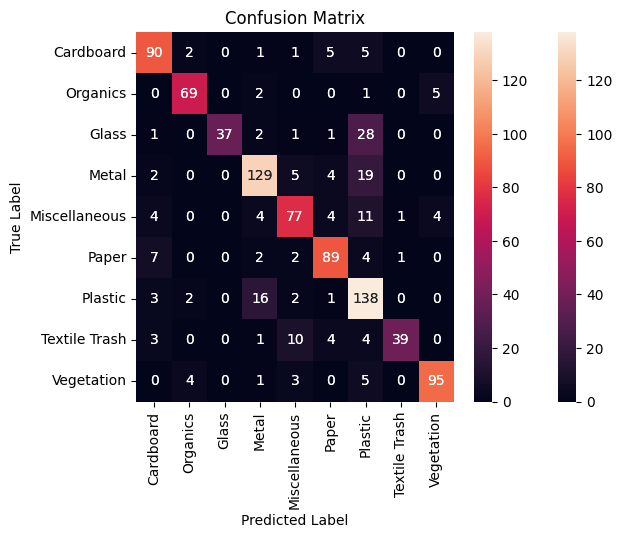

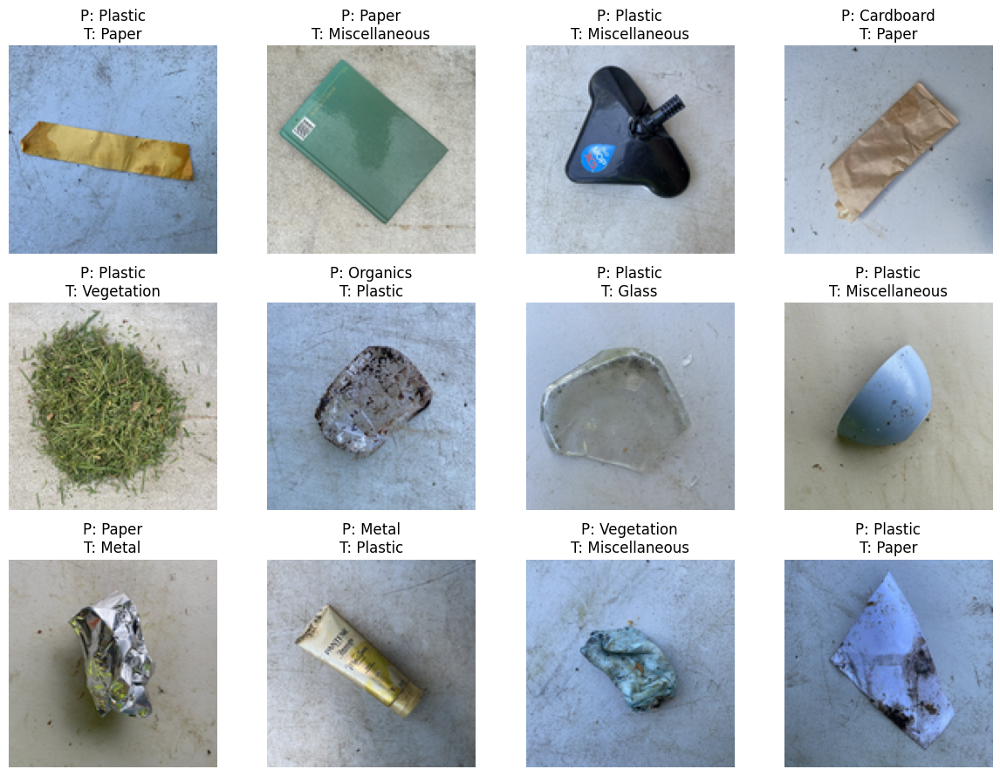

In [64]:
model_evaluation(EN_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

 # VGG-16

In [65]:
input_t = Input(shape=(131, 131, 3))
VGG = VGG16(include_top=False, weights="imagenet", input_tensor=input_t)

VGG_model_1 = Sequential([VGG])

for layer in VGG_model_1.layers:     
    layer.trainable = False
    
VGG_model_1.add(Flatten())    
VGG_model_1.add(Dense(1024, activation='relu'))
VGG_model_1.add(Dense(512, activation='relu'))
VGG_model_1.add(Dense(256, activation='relu'))
VGG_model_1.add(Dropout(0.2))
VGG_model_1.add(Dense(256, activation='relu'))
VGG_model_1.add(Dense(9, activation='softmax'))

VGG_model_1.summary()  

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 1024)              8389632   
                                                                 
 dense_1 (Dense)             (None, 512)               524800    
                                                                 
 dense_2 (Dense)             (None, 256)               131328    
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_3 (Dense)             (None, 256)               6

In [66]:
gc.collect()
tf.keras.backend.clear_session()
VGG_model_1.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
VGG_1 = CNNModel(VGG_model_1, "VGG-16 model 1")
VGG_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 13s 26ms/step - loss: 2.0620 - accuracy: 0.4177 - val_loss: 1.0241 - val_accuracy: 0.6635
Epoch 2/20
476/476 [==============================] - 12s 25ms/step - loss: 1.1543 - accuracy: 0.6001 - val_loss: 1.1010 - val_accuracy: 0.6646
Epoch 3/20
476/476 [==============================] - 12s 25ms/step - loss: 0.9534 - accuracy: 0.6760 - val_loss: 1.0066 - val_accuracy: 0.7213
Epoch 4/20
476/476 [==============================] - 12s 25ms/step - loss: 0.7536 - accuracy: 0.7461 - val_loss: 1.3949 - val_accuracy: 0.7329
Epoch 5/20
476/476 [==============================] - 11s 24ms/step - loss: 0.6380 - accuracy: 0.7887 - val_loss: 1.2173 - val_accuracy: 0.7581
Epoch 6/20
476/476 [==============================] - 11s 24ms/step - loss: 0.6352 - accuracy: 0.8032 - val_loss: 1.2334 - val_accuracy: 0.7676
Epoch 7/20
476/476 [==============================] - 11s 23ms/step - loss: 0.5048 - accuracy: 0.8375 - val_loss: 1.2340 - val_accuracy:

30/30 [==============================] - 1s 25ms/step
               precision    recall  f1-score   support

    Cardboard       0.84      0.78      0.81       104
     Organics       0.79      0.86      0.82        77
        Glass       0.89      0.79      0.83        70
        Metal       0.81      0.80      0.81       159
Miscellaneous       0.78      0.49      0.60       105
        Paper       0.78      0.78      0.78       105
      Plastic       0.75      0.83      0.79       162
Textile Trash       0.53      0.82      0.64        61
   Vegetation       0.91      0.93      0.92       108

     accuracy                           0.78       951
    macro avg       0.79      0.78      0.78       951
 weighted avg       0.80      0.78      0.78       951



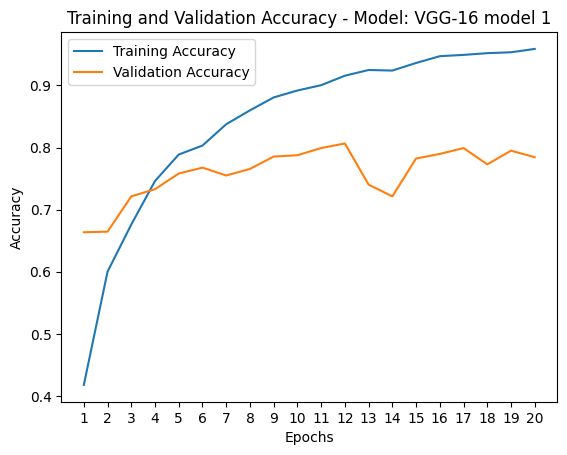

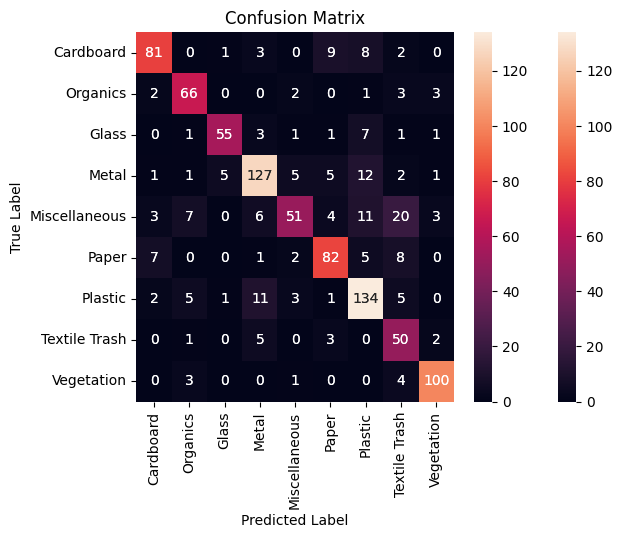

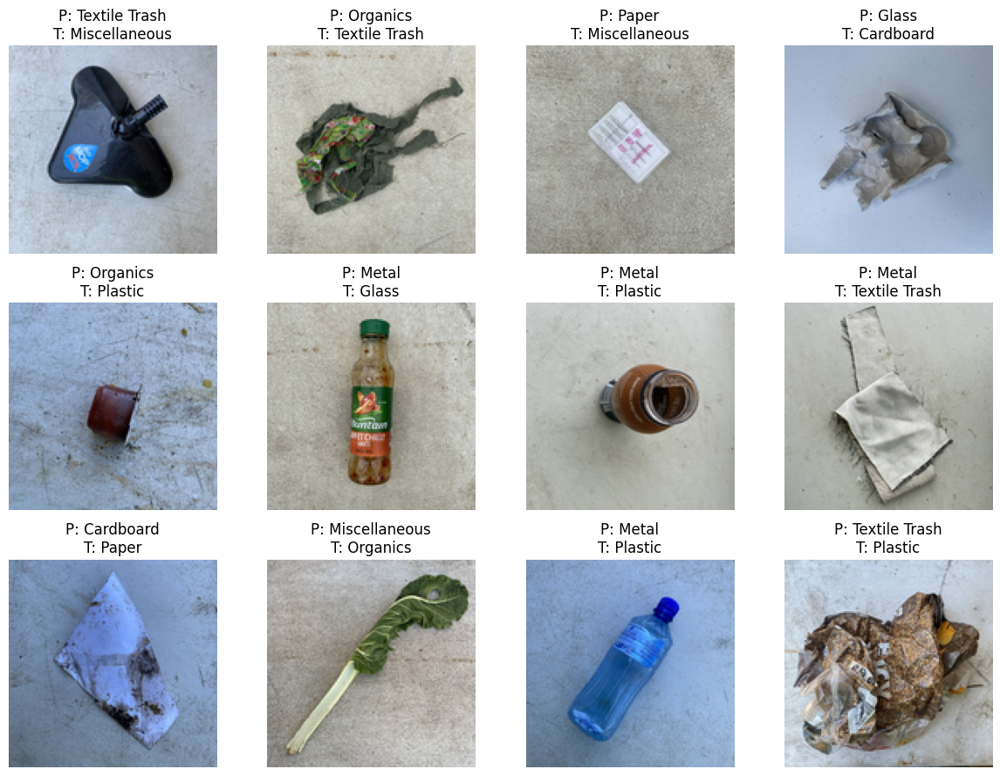

In [67]:
model_evaluation(VGG_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [17]:
input_t = Input(shape=(131, 131, 3))
VGG = VGG16(include_top=False, weights="imagenet", input_tensor=input_t)

VGG_model_2 = Sequential([VGG])

for layer in VGG_model_2.layers:     
    layer.trainable = False
    
VGG_model_2.add(Flatten())    
VGG_model_2.add(Dense(512, activation='relu'))
VGG_model_2.add(Dense(1024, activation='relu'))
VGG_model_2.add(Dense(512, activation='relu'))
VGG_model_2.add(Dropout(0.2))
VGG_model_2.add(Dense(1024, activation='relu'))
VGG_model_2.add(Dense(512, activation='relu'))
VGG_model_2.add(Dropout(0.2))
VGG_model_2.add(Dense(256, activation='relu'))
VGG_model_2.add(Dense(9, activation='softmax'))

VGG_model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 512)               4194816   
                                                                 
 dense_1 (Dense)             (None, 1024)              525312    
                                                                 
 dense_2 (Dense)             (None, 512)               524800    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 1024)              5

In [18]:
gc.collect()
tf.keras.backend.clear_session()
VGG_model_2.compile(optimizer = "adam", loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
VGG_2 = CNNModel(VGG_model_2, "VGG-16 model 1")
VGG_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20


2025-08-12 18:09:21.375183: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8906
2025-08-12 18:09:22.070230: I external/local_xla/xla/service/service.cc:168] XLA service 0x77ec70003860 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-08-12 18:09:22.070255: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2025-08-12 18:09:22.074098: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1755022162.120306   56283 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


476/476 [==============================] - 11s 18ms/step - loss: 1.7801 - accuracy: 0.3899 - val_loss: 1.1202 - val_accuracy: 0.6604
Epoch 2/20
476/476 [==============================] - 9s 18ms/step - loss: 1.2117 - accuracy: 0.5787 - val_loss: 0.8770 - val_accuracy: 0.7182
Epoch 3/20
476/476 [==============================] - 9s 19ms/step - loss: 1.0092 - accuracy: 0.6692 - val_loss: 0.8618 - val_accuracy: 0.7571
Epoch 4/20
476/476 [==============================] - 9s 18ms/step - loss: 0.8552 - accuracy: 0.7268 - val_loss: 0.9550 - val_accuracy: 0.7592
Epoch 5/20
476/476 [==============================] - 9s 18ms/step - loss: 0.7071 - accuracy: 0.7727 - val_loss: 1.0284 - val_accuracy: 0.7718
Epoch 6/20
476/476 [==============================] - 9s 19ms/step - loss: 0.7132 - accuracy: 0.7783 - val_loss: 1.2501 - val_accuracy: 0.7655
Epoch 7/20
476/476 [==============================] - 9s 19ms/step - loss: 0.6296 - accuracy: 0.8125 - val_loss: 2.3991 - val_accuracy: 0.7361
Epoch 8/2

30/30 [==============================] - 1s 23ms/step
               precision    recall  f1-score   support

    Cardboard       0.98      0.53      0.69       104
     Organics       0.88      0.82      0.85        77
        Glass       0.82      0.77      0.79        70
        Metal       0.75      0.85      0.80       159
Miscellaneous       0.61      0.66      0.63       105
        Paper       0.79      0.73      0.76       105
      Plastic       0.77      0.77      0.77       162
Textile Trash       0.53      0.89      0.67        61
   Vegetation       0.94      0.92      0.93       108

     accuracy                           0.77       951
    macro avg       0.79      0.77      0.76       951
 weighted avg       0.79      0.77      0.77       951



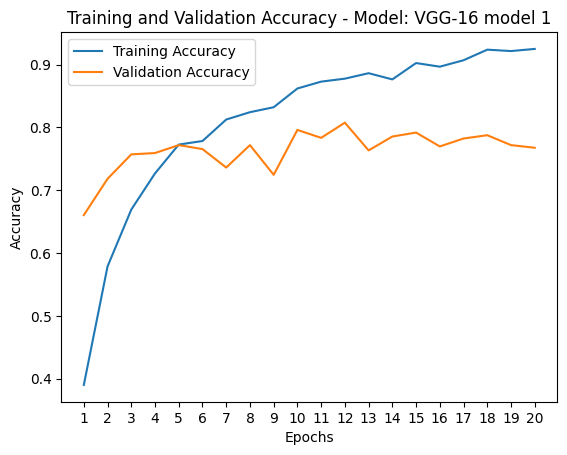

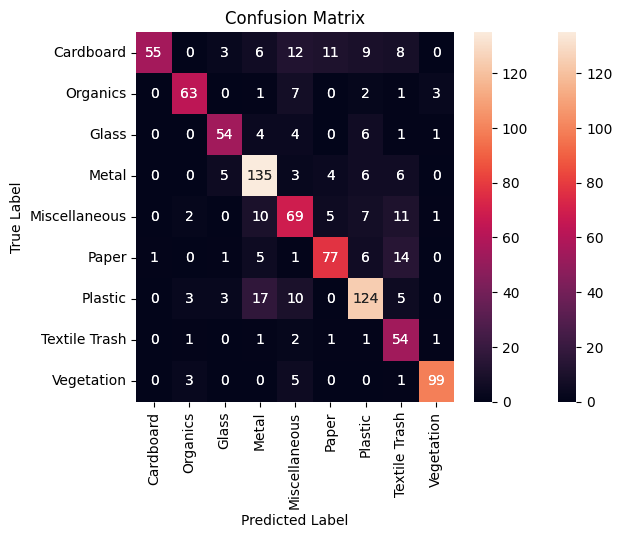

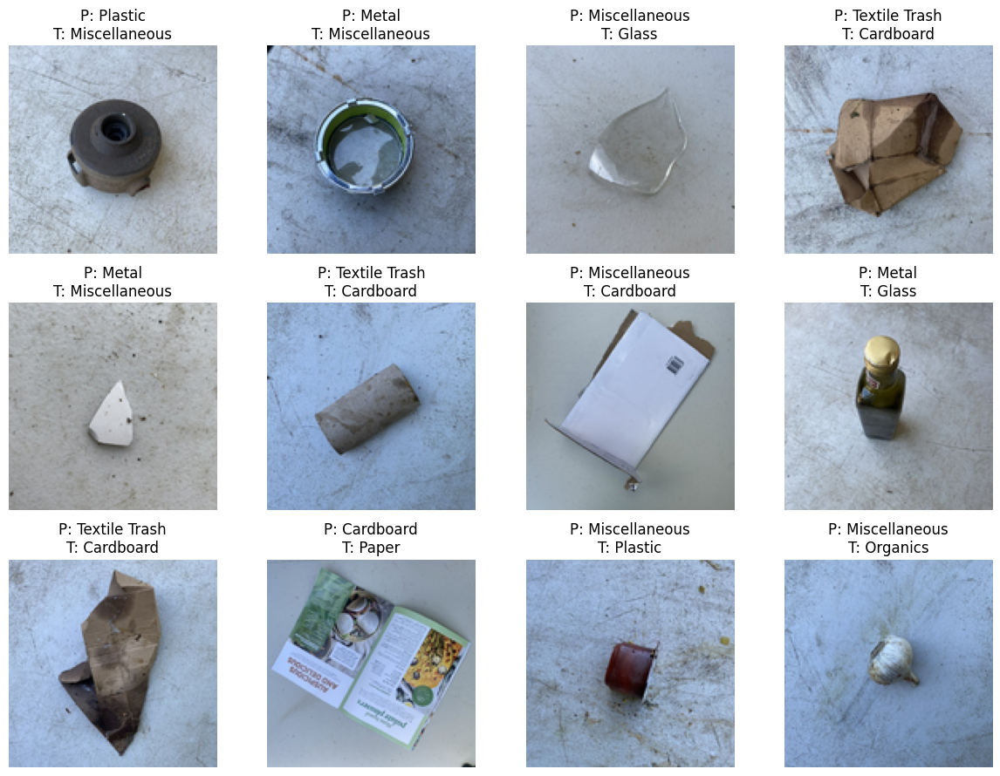

In [19]:
model_evaluation(VGG_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

I think that's more than enough models for this first modeling notebook.  I'm going to step back, assess and document all these results, and then consider some subsequent work: a notebook to model the variability we have in model fitting.  And perhaps I'd like to see if we can apply CNN's in a hierarchial manner - that is, maybe a first CNN to differentiate among vegetation-organics, paper-cardboard, and glass-plastic-metal (for example) and then a second one to classify further?  There's a lot of fertile ground here.